In [308]:
import os
import sys
sys.path.append('C:\\Users\\dhruv\\Anaconda3\\envs\\testPanorama\\Lib\\site-packages')
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import imutils
from imutils import paths
from sklearn.datasets import make_classification
from sklearn.cluster import MeanShift
from matplotlib import pyplot
import random
import pickle
import csv

In [309]:
!export PATH=/Library/TeX/texbin:$PATH

'export' is not recognized as an internal or external command,
operable program or batch file.


In [97]:
# a = np.array([[0,60], [1,2], [3,4]])
# b = np.array([[12,23],[68,26]])
# a = a.ravel()
# print(a)
# a = a.reshape(-1, a.shape[0])
# b = b.ravel()
# b = b.reshape(-1, b.shape[0])
# print(a.shape)
# print(a)

# list = [a,b]
# print(type(list))
# print(len(list))
# print(tuple(list))

# with open('coordinatesFromPostProcessing-dummy.csv', 'ab') as f:
#     np.savetxt(f, a, delimiter=',')
#     np.savetxt(f, b, delimiter=',')

[ 0 60  1  2  3  4]
(1, 6)
[[ 0 60  1  2  3  4]]
<class 'list'>
2
(array([[ 0, 60,  1,  2,  3,  4]]), array([[12, 23, 68, 26]]))


ValueError: could not broadcast input array from shape (6) into shape (1)

In [322]:
feature_extractor = 'sift' # one of 'sift', 'surf', 'brisk', 'orb'
feature_matching = 'bf'
imgPath = "F:\\IIIT-H Work\\win_det_heatmaps\\datasets\\IIIT-H Dataset\\Bakul-All\\003\\images\\"
windowCount = 0

In [312]:
# Displaying the contents of the text file

# del list

with open('..\\win_det_heatmaps\coordinatesFromPostProcessing-3-shufflenet.csv', newline='') as f:
    csvread = csv.reader(f)
    print(csvread)
    batch_data = list(csvread)
print(len(batch_data))

20


In [313]:
print(batch_data[0])


batch_data_int = []
for inner_list in batch_data:
    innet_out_list = []
    for string in inner_list:
        innet_out_list.append(int(float(string)))
    batch_data_int.append(innet_out_list)

print(batch_data_int)
print(len(batch_data_int))
print(batch_data_int[1][0])
FinalList = []
for i in range(len(batch_data_int)):
    el = batch_data_int[i]
    elChunks = [el[x:x+4] for x in range(0, len(el), 4)]
    print("elChunks:", elChunks)
    newElChunks = elChunks.copy()
    for i in range(len(elChunks)):
#         newChunk = newElChunks[i]        
        chunk = elChunks[i]
        newChunk = chunk.copy()
        print("newChunk", newChunk)
        print("chunk", chunk)
        newChunk.insert(2, chunk[0])
        newChunk.insert(3, chunk[3])
        newChunk.insert(6, chunk[2])
        newChunk.insert(7, chunk[1])
        print("newModifiedChunk", newChunk)
        newElChunks[i] = newChunk
    print(newElChunks)
    perImageCoords = np.array(newElChunks)
    perImageCoords = perImageCoords.reshape(-1,4,2)
    FinalList.append(perImageCoords)

print("Final list:", FinalList)
print("Final list size:", len(FinalList))
print("Final list:", FinalList[0].shape)
print("Final list:", FinalList[0])

['3.150000000000000000e+02', '4.200000000000000000e+01', '4.720000000000000000e+02', '1.870000000000000000e+02']
[[315, 42, 472, 187], [319, 97, 514, 272, 715, 97, 903, 265], [315, 135, 507, 302, 702, 130, 885, 292], [717, 182, 862, 312, 337, 175, 482, 305], [319, 207, 512, 365, 700, 202, 878, 362], [710, 342, 855, 450, 337, 335, 482, 440], [710, 377, 857, 485, 337, 370, 482, 477, 326, 0, 521, 102, 716, 0, 906, 97], [702, 445, 845, 545, 332, 440, 472, 537, 307, 0, 507, 172, 707, 0, 902, 167], [707, 497, 850, 590, 342, 490, 482, 580, 324, 47, 521, 227, 716, 47, 908, 222], [702, 537, 840, 625, 345, 530, 482, 615, 321, 95, 518, 270, 714, 95, 904, 262], [672, 597, 810, 682, 307, 595, 450, 675, 282, 150, 477, 325, 680, 147, 870, 317], [680, 625, 820, 705, 315, 617, 455, 700, 292, 180, 492, 352, 707, 195, 860, 337], [312, 652, 447, 725, 294, 227, 489, 387, 668, 225, 856, 382], [281, 297, 478, 452, 690, 312, 842, 437], [300, 347, 492, 497, 687, 340, 872, 490, 291, 0, 498, 97, 706, 0, 904, 92]

Final list: [array([[[315,  42],
        [315, 187],
        [472, 187],
        [472,  42]]]), array([[[319,  97],
        [319, 272],
        [514, 272],
        [514,  97]],

       [[715,  97],
        [715, 265],
        [903, 265],
        [903,  97]]]), array([[[315, 135],
        [315, 302],
        [507, 302],
        [507, 135]],

       [[702, 130],
        [702, 292],
        [885, 292],
        [885, 130]]]), array([[[717, 182],
        [717, 312],
        [862, 312],
        [862, 182]],

       [[337, 175],
        [337, 305],
        [482, 305],
        [482, 175]]]), array([[[319, 207],
        [319, 365],
        [512, 365],
        [512, 207]],

       [[700, 202],
        [700, 362],
        [878, 362],
        [878, 202]]]), array([[[710, 342],
        [710, 450],
        [855, 450],
        [855, 342]],

       [[337, 335],
        [337, 440],
        [482, 440],
        [482, 335]]]), array([[[710, 377],
        [710, 485],
        [857, 485],
        [857, 377]]

In [314]:
def calculateRange(coordinates, padding, imageShape):
    minX = maxX = coordinates[0][0]
    minY = maxY = coordinates[0][1]
    startX = startY = endX = endY = 0
    h,w,c = imageShape
    for i in range(len(coordinates)):
        if minX > coordinates[i][0]:
            minX = coordinates[i][0]
        if maxX < coordinates[i][0]:
            maxX = coordinates[i][0]

        if minY > coordinates[i][1]:
            minY = coordinates[i][1]
        if maxY < coordinates[i][1]:
            maxY = coordinates[i][1]
    
    if (minX - padding < 0):
        startX = 0
    else:
        startX = minX - padding
    if (minY - padding < 0):
        startY = 0
    else:
        startY = minY - padding
    if (maxX + padding >= w):
        endX = w - 1
    else:
        endX = maxX + padding
    if (maxY + padding >= h):
        endY = h - 1
    else:
        endY = maxY + padding
    return startX, endX, startY, endY

def prepareBinaryMask(img_gray, coordinates):
    ret, binary_img = cv2.threshold(img_gray, 255, 255, cv2.THRESH_BINARY)
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], 5, (720,960,3))
        binary_img[startY:endY, startX:endX] = 1
    return binary_img

def mapToPick(coordinates):
    pick = []
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], 5, (720,960,3))
        pick.append([startX, startY, endX, endY])
    return pick

def mapToPickv1(coordinates):
    pick = []
    for i in range(coordinates.shape[0]):
        startX, startY = coordinates[i][0]
        endX, endY = coordinates[i][2]
        pick.append([startX, startY, endX, endY])
    return pick
    

In [315]:
ans = mapToPickv1(FinalList[4])
print(len(ans))

2








# SIFT Feature Matching on Bounding Box Descriptors(Window masks):




In [316]:
def detectAndDescribe(image, mask, method=None):
    """
    Compute key points and feature descriptors using an specific method
    """
    
    assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"
    
    # detect and extract features from the image
    if method == 'sift':
        descriptor = cv2.xfeatures2d.SIFT_create()
    elif method == 'surf':
        descriptor = cv2.xfeatures2d.SURF_create()
    elif method == 'brisk':
        descriptor = cv2.BRISK_create()
    elif method == 'orb':
        descriptor = cv2.ORB_create()
        
    # get keypoints and descriptors
    (kps, features) = descriptor.detectAndCompute(image, mask)
#     kps = np.float32([kp.pt for kp in kps])
    return (kps, features)

def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"
    
    if method == 'sift' or method == 'surf':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk':
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
    return bf

def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)
        
    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)
    
    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    print(rawMatches)
    matches = []

    # loop over the raw matches
    for m,n in rawMatches:
        print('m: ' + str(m) + ' n: ' + str(n))
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches







# Homography Calculation and Outlier Rejection





In [317]:
#
# Computers a homography from 4-correspondences
#
def calculateHomography(correspondences):
    #loop through correspondences and create assemble matrix
    aList = []
    for corr in correspondences:
        p1 = np.matrix([corr.item(0), corr.item(1), 1])
        p2 = np.matrix([corr.item(2), corr.item(3), 1])

        a2 = [0, 0, 0, -p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2),
              p2.item(1) * p1.item(0), p2.item(1) * p1.item(1), p2.item(1) * p1.item(2)]
        a1 = [-p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2), 0, 0, 0,
              p2.item(0) * p1.item(0), p2.item(0) * p1.item(1), p2.item(0) * p1.item(2)]
        aList.append(a1)
        aList.append(a2)

    matrixA = np.matrix(aList)

    #svd composition
    u, s, v = np.linalg.svd(matrixA)

    #reshape the min singular value into a 3 by 3 matrix
    h = np.reshape(v[8], (3, 3))

    #normalize and now we have h
    h = (1/h.item(8)) * h
    return h


#
#Calculate the geometric distance between estimated points and original points
#
def geometricDistance(correspondence, h):
#     print("H: ", h)
#     print("correspondence: ", correspondence)
    p1 = np.transpose(np.matrix([correspondence[0].item(0), correspondence[0].item(1), 1]))
    estimatep2 = np.dot(h, p1)
#     print("estimatep2: ", estimatep2)
#     print(estimatep2.item(2))
    if estimatep2.item(2) == 0:
        return None
    estimatep2 = (1/estimatep2.item(2))*estimatep2
    
#     print("TRANSFORMED estimatep2: ", estimatep2)
    p2 = np.transpose(np.matrix([correspondence[0].item(2), correspondence[0].item(3), 1]))
    error = p2 - estimatep2
    return np.linalg.norm(error)


#
#Runs through ransac algorithm, creating homographies from random correspondences
#
def ransac(corr, thresh):
    maxInliers = []
    finalH = None
    for i in range(1000):
        #find 4 random points to calculate a homography
        corr1 = corr[random.randrange(0, len(corr))]
        corr2 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((corr1, corr2))
        corr3 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr3))
        corr4 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr4))

        #call the homography function on those points
        h = calculateHomography(randomFour)
        inliers = []
        continueFlag = False 
        
        for i in range(len(corr)):
            d = geometricDistance(corr[i], h)
            
            ## set the flag if divide by zero error
            if d == None:
                continueFlag = True
                break
            if d < 5:
                inliers.append(corr[i])
        
        ## Skip the set if divide by zero error
        if(continueFlag == True):
            continue
            
        if len(inliers) > len(maxInliers):
            maxInliers = inliers
            finalH = h
#         print("Corr size: ", len(corr), " NumInliers: ", len(inliers), "Max inliers: ", len(maxInliers))

        if len(maxInliers) > (len(corr)*thresh):
            break
    return finalH, maxInliers

# This draws matches and optionally a set of inliers in a different color
# Note: I lifted this drawing portion from stackoverflow and adjusted it to my needs because OpenCV 2.4.11 does not
# include the drawMatches function
def drawMatches(img1, kp1, img2, kp2, matches, inliers = None):
    print(img1.shape)
    print(img2.shape)
    # Create a new output image that concatenates the two images together
    rows1 = img1.shape[0]
    cols1 = img1.shape[1]
    rows2 = img2.shape[0]
    cols2 = img2.shape[1]

    out = np.zeros((max([rows1,rows2]),cols1+cols2,3), dtype='uint8')

    # Place the first image to the left
    print(np.dstack([img1, img1, img1]).shape)
    out[:rows1,:cols1,:] = img1 #np.dstack([img1, img1, img1])

    # Place the next image to the right of it
    out[:rows2,cols1:cols1+cols2,:] = img2 #np.dstack([img2, img2, img2])

    # For each pair of points we have between both images
    # draw circles, then connect a line between them
    for mat in matches:

        # Get the matching keypoints for each of the images
        img1_idx = mat.queryIdx
        img2_idx = mat.trainIdx

        # x - columns, y - rows
        (x1,y1) = kp1[img1_idx].pt
        (x2,y2) = kp2[img2_idx].pt

        inlier = False

        if inliers is not None:
            for i in inliers:
                if i.item(0) == x1 and i.item(1) == y1 and i.item(2) == x2 and i.item(3) == y2:
                    inlier = True

        # Draw a small circle at both co-ordinates
        cv2.circle(out, (int(x1),int(y1)), 4, (255, 0, 0), 1)
        cv2.circle(out, (int(x2)+cols1,int(y2)), 4, (255, 0, 0), 1)

        # Draw a line in between the two points, draw inliers if we have them
        if inliers is not None and inlier:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 255, 0), 1)
        elif inliers is not None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 0, 255), 1)

        if inliers is None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (255, 0, 0), 1)

    return out

In [318]:
## Calculating homography and rejecting outliers

def rejectOutliers(matches, img1, img2, kpsA, kpsB, estimation_thresh = 0.60):
    correspondenceList = []
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)

    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
    print("Inliers: " +  str(inliers))

    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    # for inlier in inliers:
    #     print(inlier[0][0])

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    print(inliers)
    
    return inliers





# Calculation of New Unmatched Windows from inliers in Current Frame:



In [319]:
## For calculation of new Windows in the current Frame
## Take care of many one correspondences even after outlier rejection!!!!

def isInsideBox(rectCoords, coords):
    sX, sY, eX, eY = rectCoords
    x, y = coords
    if x >= sX and x <= eX and y >= sY and y <= eY:
        return True
    return False

def calculateUnMatchedWindows(inliers, picksA, picksB):
    clusterInfoA = []
    clusterInfoB = []
    id1 = 1
    id2 = 1
    newWindowsCount = 0
    newWindows = []
    matchedWindowsInA = []
    
    for box in picksB:
        newBox = True
        print("box2: ", box)
        for inlier in inliers:
            ptA = (int(inlier[0]), int(inlier[1]))
            ptB = (int(inlier[2]), int(inlier[3]))
            print("pointB: ", ptB)
            ## Assign box from A to this inlier
            matchedWindowInA = None
            for box1 in picksA:
                if isInsideBox(box1, ptA) == True:
                    matchedWindowInA = box1
                    break
                    
            print("listA: ", matchedWindowsInA)
            print("ElementA: ", matchedWindowInA)
            print("count: ", matchedWindowsInA.count(matchedWindowInA))
            if isInsideBox(box, ptB) == True and (matchedWindowsInA.count(matchedWindowInA) == 0):
                print("oldBox")
                newBox = False
                matchedWindowsInA.append(matchedWindowInA)
                break
                    
        if newBox == True:
            newWindowsCount += 1 
            newWindows.append(box)
        print("newCountInItr:", newWindowsCount)
    
    print("new Windows Count: ", newWindowsCount)
    return newWindows, newWindowsCount

In [320]:
calculateUnMatchedWindows(inliers, pick, pick2)

box2:  [709, 405, 859, 542]
pointB:  (381, 427)
listA:  []
ElementA:  None
count:  0
pointB:  (495, 428)
listA:  []
ElementA:  None
count:  0
pointB:  (763, 174)
listA:  []
ElementA:  [598, 0, 793, 140]
count:  0
pointB:  (354, 434)
listA:  []
ElementA:  None
count:  0
pointB:  (838, 175)
listA:  []
ElementA:  None
count:  0
pointB:  (369, 427)
listA:  []
ElementA:  None
count:  0
pointB:  (396, 437)
listA:  []
ElementA:  None
count:  0
pointB:  (345, 532)
listA:  []
ElementA:  None
count:  0
pointB:  (57, 504)
listA:  []
ElementA:  None
count:  0
pointB:  (491, 529)
listA:  []
ElementA:  None
count:  0
pointB:  (381, 512)
listA:  []
ElementA:  None
count:  0
pointB:  (342, 157)
listA:  []
ElementA:  [189, 0, 389, 142]
count:  0
pointB:  (379, 482)
listA:  []
ElementA:  None
count:  0
pointB:  (83, 504)
listA:  []
ElementA:  None
count:  0
pointB:  (414, 494)
listA:  []
ElementA:  None
count:  0
pointB:  (134, 512)
listA:  []
ElementA:  None
count:  0
pointB:  (384, 531)
listA:  []
Ele

([[709, 405, 859, 542], [0, 420, 135, 527]], 2)

[INFO] loading images...
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000070.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000120.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000150.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000170.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000200.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000310.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000330.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000390.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000430.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\003\images\Bakul_003_000470

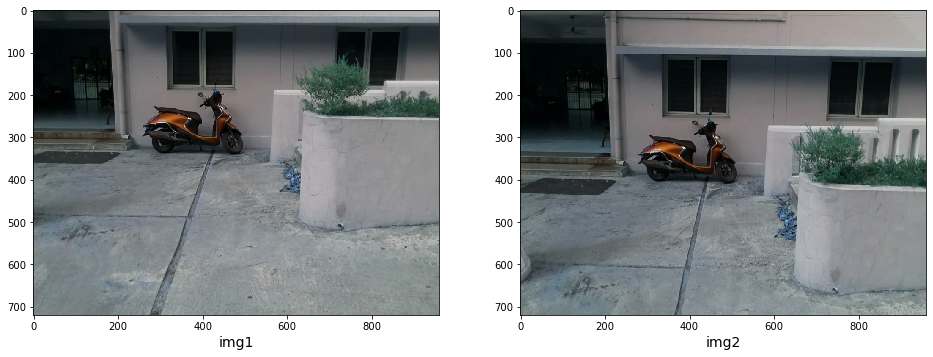

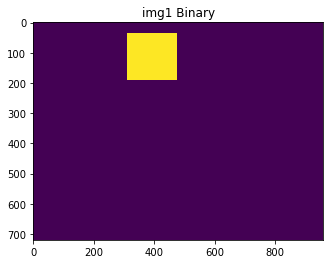

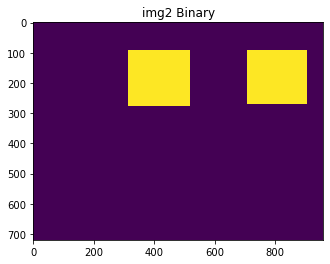

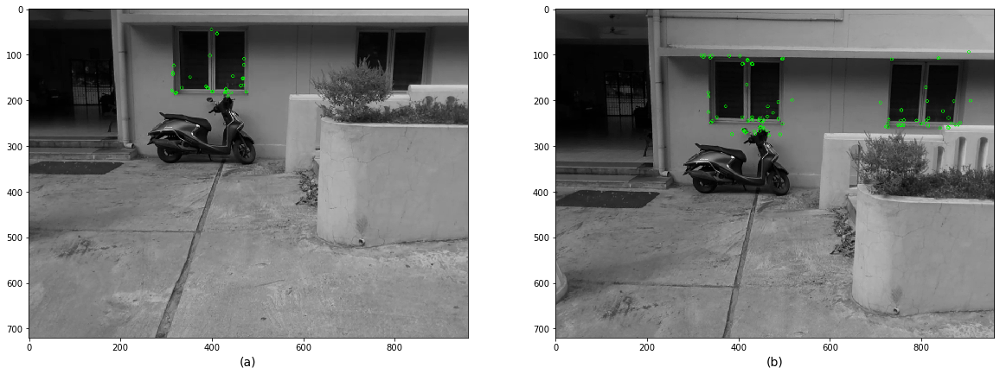

Using: bf feature matcher
Raw matches (Brute force): 34


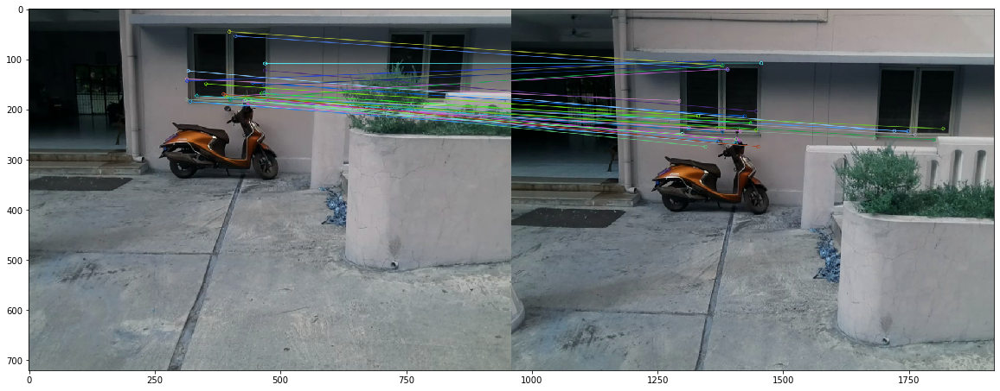

Final homography:  [[ 9.03196875e-01 -2.35910224e-02  4.16627712e+01]
 [-1.99412248e-02  9.30471070e-01  7.38658051e+01]
 [-9.94152761e-05 -3.08943796e-05  1.00000000e+00]]
Final inliers count:  9
Inliers: [matrix([[445.87823486, 147.30155945, 463.59609985, 213.57365417]]), matrix([[402.29370117, 180.83178711, 419.88592529, 245.28250122]]), matrix([[352.42730713, 149.47254944, 371.32821655, 213.19090271]]), matrix([[390.68865967, 173.06323242, 408.12240601, 236.94845581]]), matrix([[320.89163208, 184.71253967, 339.91717529, 248.6892395 ]]), matrix([[411.32626343,  53.88974762, 430.20843506, 120.95373535]]), matrix([[411.32626343,  53.88974762, 430.20843506, 120.95373535]]), matrix([[334.18228149, 172.66960144, 352.36434937, 236.81686401]]), matrix([[398.97186279,  45.32447433, 418.11312866, 112.7113266 ]])]
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


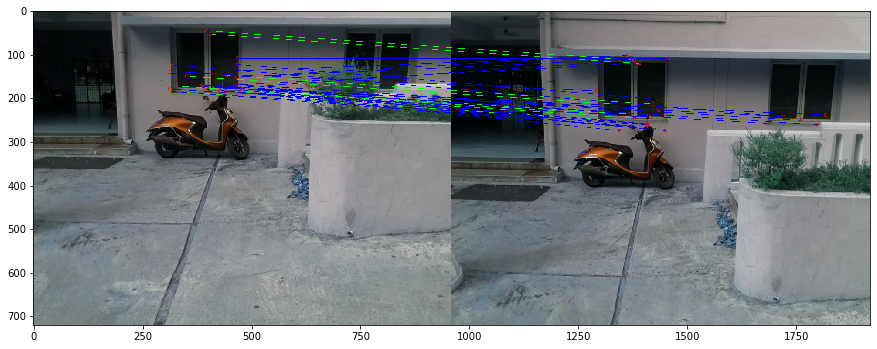

pick1: [[315, 42, 472, 187]]
pick2: [[319, 97, 514, 272], [715, 97, 903, 265]]
box2:  [319, 97, 514, 272]
pointB:  (463, 213)
listA:  []
ElementA:  [315, 42, 472, 187]
count:  0
oldBox
newCountInItr: 0
box2:  [715, 97, 903, 265]
pointB:  (463, 213)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (419, 245)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (371, 213)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (408, 236)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (339, 248)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (430, 120)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (430, 120)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (352, 236)
listA:  [[315, 42, 472, 187]]
ElementA:  [315, 42, 472, 187]
count:  1
pointB:  (418, 112)
listA:  [[315, 42, 472,

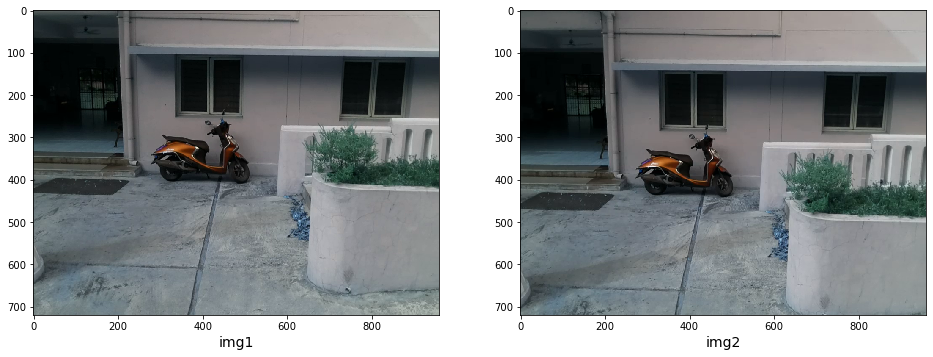

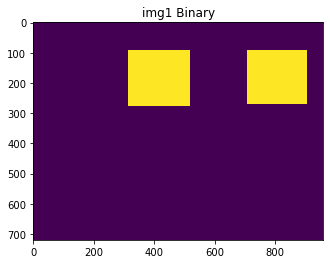

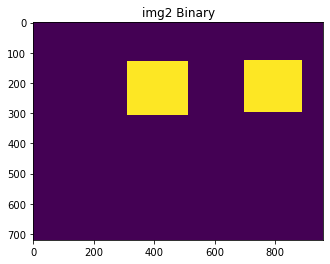

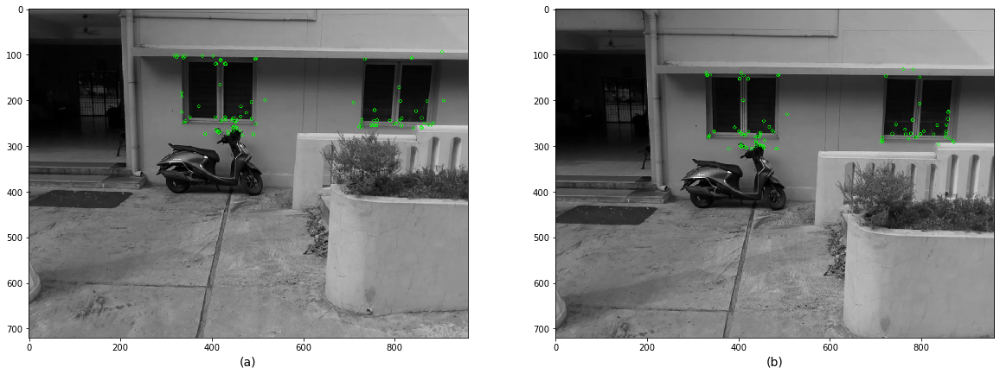

Using: bf feature matcher
Raw matches (Brute force): 63


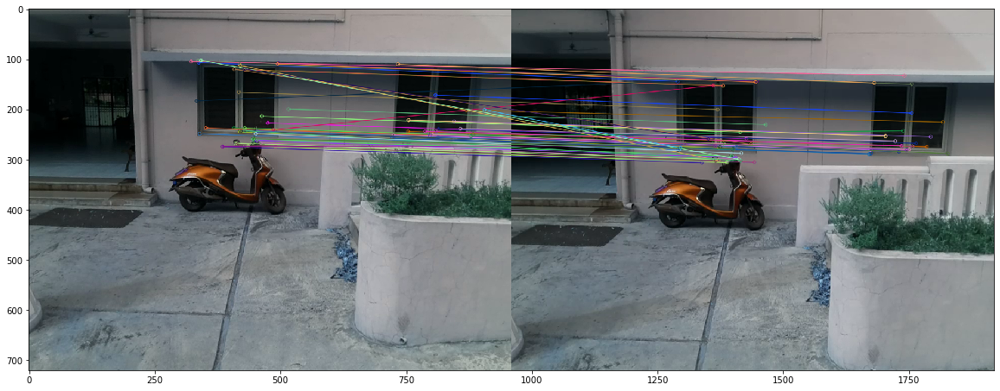

Final homography:  [[ 9.82570220e-01  8.25782290e-02 -9.57403810e+00]
 [-2.60463012e-02  1.07618761e+00  3.42480995e+01]
 [-3.83904219e-05  1.75174027e-04  1.00000000e+00]]
Final inliers count:  40
Inliers: [matrix([[475.44778442, 227.21034241, 466.7555542 , 258.21929932]]), matrix([[463.59609985, 213.57365417, 454.9664917 , 245.49226379]]), matrix([[385.39651489, 274.18655396, 378.47967529, 306.30914307]]), matrix([[516.65209961, 199.58641052, 505.90563965, 230.57247925]]), matrix([[336.63949585, 102.84209442, 328.57797241, 140.36846924]]), matrix([[725.50744629, 251.00041199, 714.17553711, 280.81866455]]), matrix([[339.91717529, 248.6892395 , 333.71859741, 280.57922363]]), matrix([[810.28826904, 243.50405884, 797.31872559, 273.75192261]]), matrix([[408.12240601, 236.94845581, 400.78933716, 268.11941528]]), matrix([[445.80776978, 267.25601196, 437.53738403, 301.30484009]]), matrix([[490.61550903, 274.67364502, 483.04260254, 305.66903687]]), matrix([[490.61550903, 274.67364502, 483.042

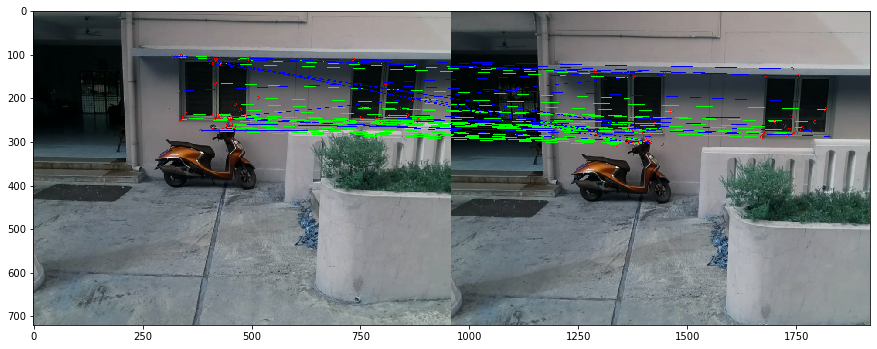

pick1: [[319, 97, 514, 272], [715, 97, 903, 265]]
pick2: [[315, 135, 507, 302], [702, 130, 885, 292]]
box2:  [315, 135, 507, 302]
pointB:  (466, 258)
listA:  []
ElementA:  [319, 97, 514, 272]
count:  0
oldBox
newCountInItr: 0
box2:  [702, 130, 885, 292]
pointB:  (466, 258)
listA:  [[319, 97, 514, 272]]
ElementA:  [319, 97, 514, 272]
count:  1
pointB:  (454, 245)
listA:  [[319, 97, 514, 272]]
ElementA:  [319, 97, 514, 272]
count:  1
pointB:  (378, 306)
listA:  [[319, 97, 514, 272]]
ElementA:  None
count:  0
pointB:  (505, 230)
listA:  [[319, 97, 514, 272]]
ElementA:  None
count:  0
pointB:  (328, 140)
listA:  [[319, 97, 514, 272]]
ElementA:  [319, 97, 514, 272]
count:  1
pointB:  (714, 280)
listA:  [[319, 97, 514, 272]]
ElementA:  [715, 97, 903, 265]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


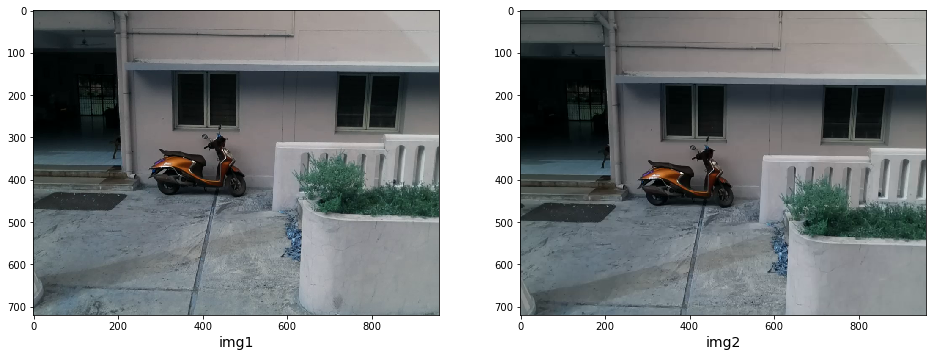

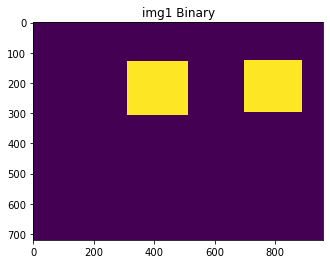

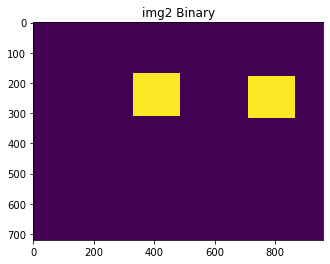

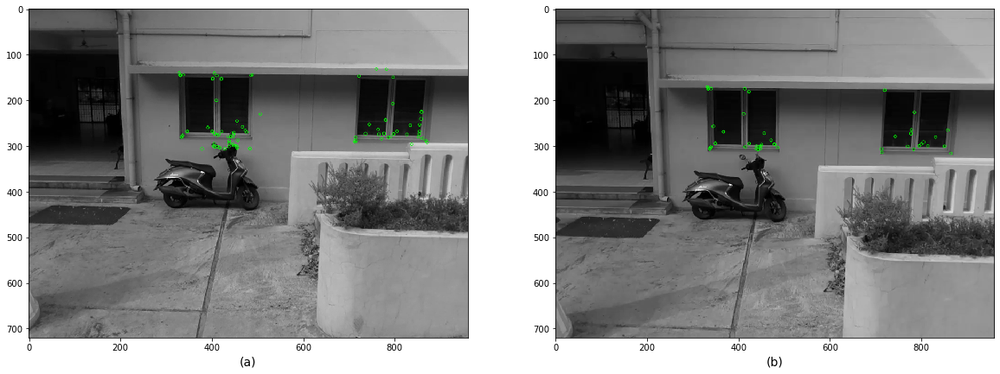

Using: bf feature matcher
Raw matches (Brute force): 39


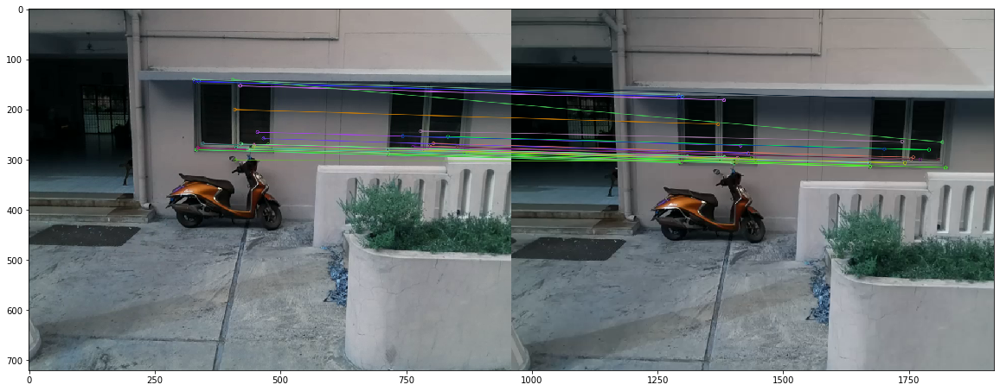

Final homography:  [[ 7.77591696e-01 -7.63399700e-01  1.93213921e+02]
 [ 2.43853566e-02  5.31778019e-01  6.28731321e+01]
 [ 7.28646874e-05 -1.08611446e-03  1.00000000e+00]]
Final inliers count:  25
Inliers: [matrix([[797.31872559, 273.75192261, 794.22143555, 299.55328369]]), matrix([[797.31872559, 273.75192261, 794.22143555, 299.55328369]]), matrix([[334.24316406, 279.9284668 , 337.20889282, 305.73287964]]), matrix([[779.55181885, 243.41308594, 777.10028076, 264.35324097]]), matrix([[346.17617798, 267.95040894, 349.09750366, 293.63504028]]), matrix([[721.48632812, 147.40560913, 719.02160645, 177.99324036]]), matrix([[715.41436768, 288.1038208 , 713.20056152, 313.90921021]]), matrix([[412.49703979, 276.52157593, 414.38830566, 302.11590576]]), matrix([[476.00335693, 269.57891846, 477.71057129, 295.94799805]]), matrix([[345.65228271, 268.50192261, 348.36807251, 294.37243652]]), matrix([[743.73883057, 253.22769165, 741.57232666, 278.91146851]]), matrix([[785.69934082, 281.39154053, 782.636

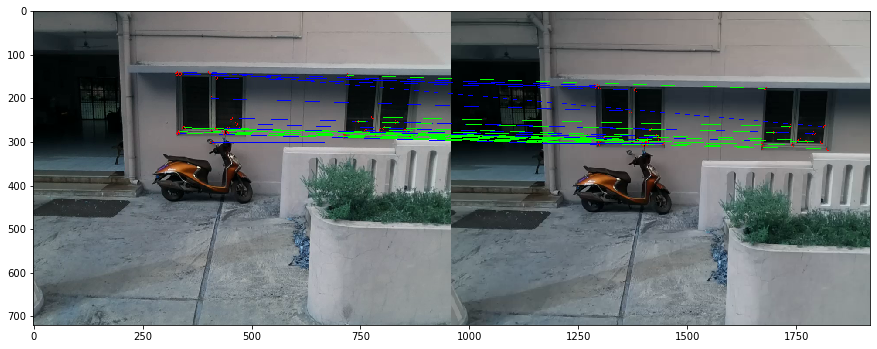

pick1: [[315, 135, 507, 302], [702, 130, 885, 292]]
pick2: [[717, 182, 862, 312], [337, 175, 482, 305]]
box2:  [717, 182, 862, 312]
pointB:  (794, 299)
listA:  []
ElementA:  [702, 130, 885, 292]
count:  0
oldBox
newCountInItr: 0
box2:  [337, 175, 482, 305]
pointB:  (794, 299)
listA:  [[702, 130, 885, 292]]
ElementA:  [702, 130, 885, 292]
count:  1
pointB:  (794, 299)
listA:  [[702, 130, 885, 292]]
ElementA:  [702, 130, 885, 292]
count:  1
pointB:  (337, 305)
listA:  [[702, 130, 885, 292]]
ElementA:  [315, 135, 507, 302]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


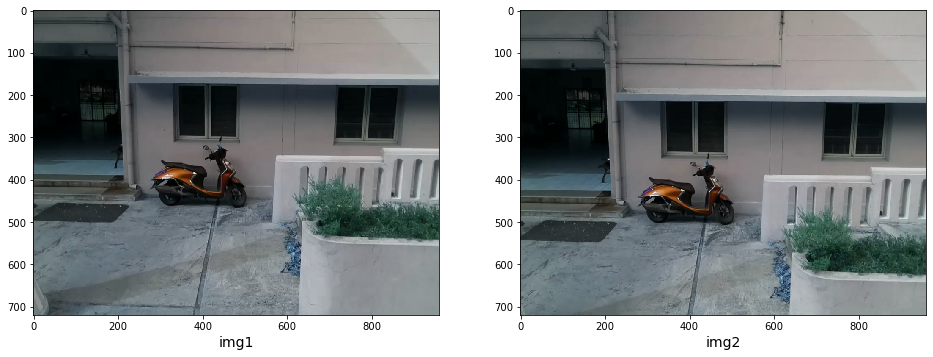

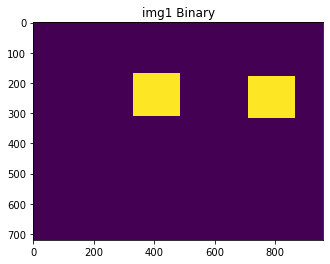

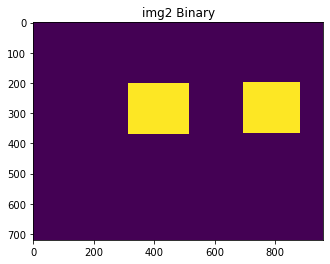

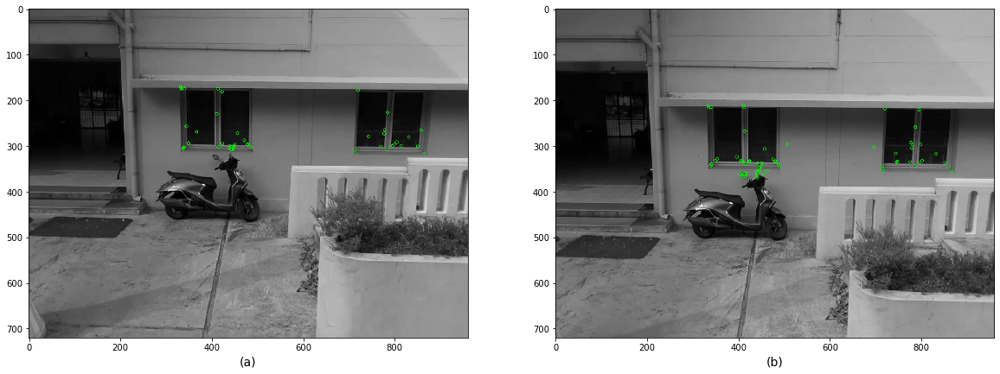

Using: bf feature matcher
Raw matches (Brute force): 43


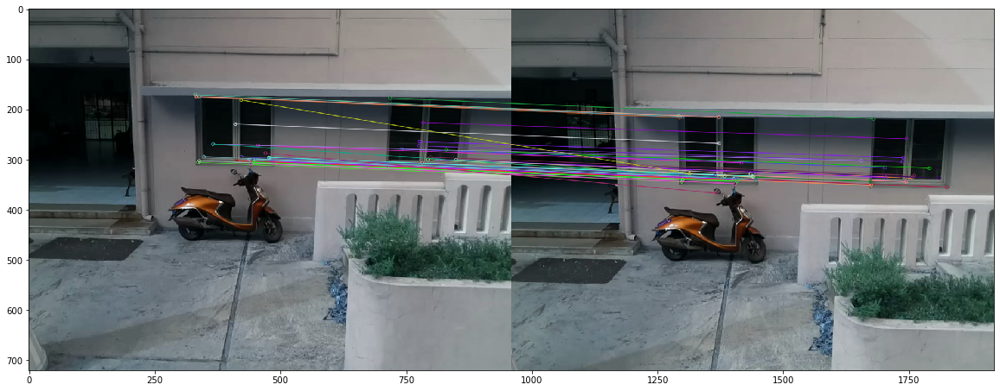

Final homography:  [[ 1.14976364e+00  5.13900627e-01 -1.43060002e+02]
 [-1.59106115e-02  1.39243178e+00 -1.48451467e+01]
 [-3.93736661e-05  6.36039889e-04  1.00000000e+00]]
Final inliers count:  28
Inliers: [matrix([[794.22143555, 299.55328369, 795.97589111, 336.5413208 ]]), matrix([[776.06500244, 272.75735474, 778.07769775, 304.41622925]]), matrix([[849.71862793, 300.66540527, 850.92907715, 336.75024414]]), matrix([[777.10028076, 264.35324097, 779.09356689, 296.0664978 ]]), matrix([[477.71057129, 295.94799805, 478.81430054, 332.8180542 ]]), matrix([[423.16436768, 294.67935181, 424.15408325, 332.58148193]]), matrix([[337.20889282, 305.73287964, 338.58999634, 343.72982788]]), matrix([[741.57232666, 278.91146851, 742.85894775, 316.16912842]]), matrix([[782.63604736, 307.11102295, 784.60961914, 343.89086914]]), matrix([[798.94396973, 295.3651123 , 801.23907471, 331.50311279]]), matrix([[830.06066895, 280.4793396 , 831.43463135, 316.9720459 ]]), matrix([[863.38476562, 316.03475952, 865.653

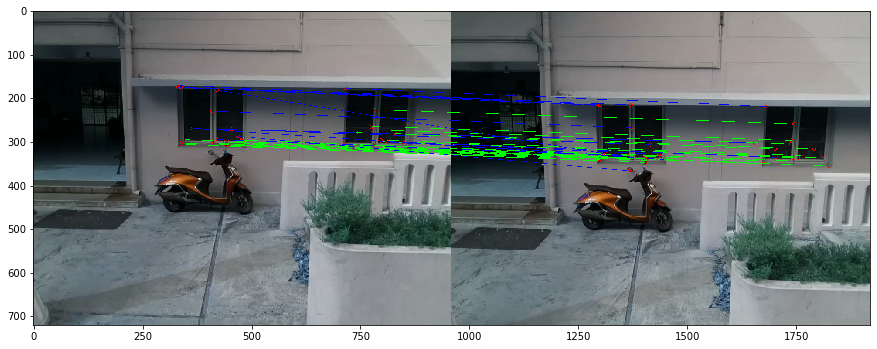

pick1: [[717, 182, 862, 312], [337, 175, 482, 305]]
pick2: [[319, 207, 512, 365], [700, 202, 878, 362]]
box2:  [319, 207, 512, 365]
pointB:  (795, 336)
listA:  []
ElementA:  [717, 182, 862, 312]
count:  0
pointB:  (778, 304)
listA:  []
ElementA:  [717, 182, 862, 312]
count:  0
pointB:  (850, 336)
listA:  []
ElementA:  [717, 182, 862, 312]
count:  0
pointB:  (779, 296)
listA:  []
ElementA:  [717, 182, 862, 312]
count:  0
pointB:  (478, 332)
listA:  []
ElementA:  [337, 175, 482, 305]
count:  0
oldBox
newCountInItr: 0
box2:  [700, 202, 878, 362]
pointB:  (795, 336)
listA:  [[337, 175, 482, 305]]
ElementA:  [717, 182, 862, 312]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


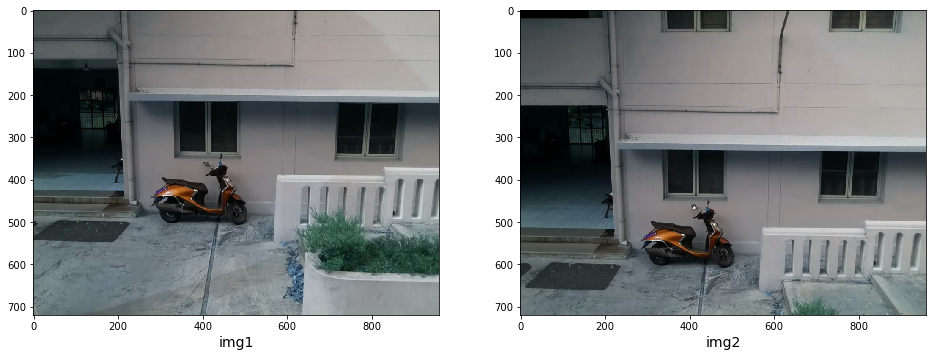

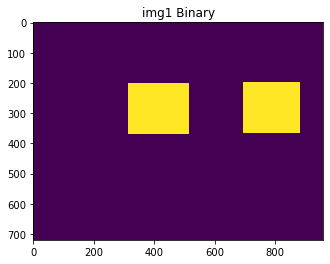

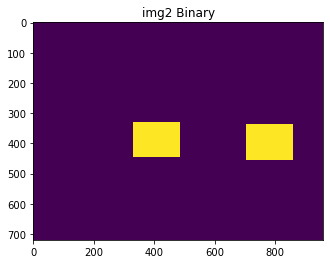

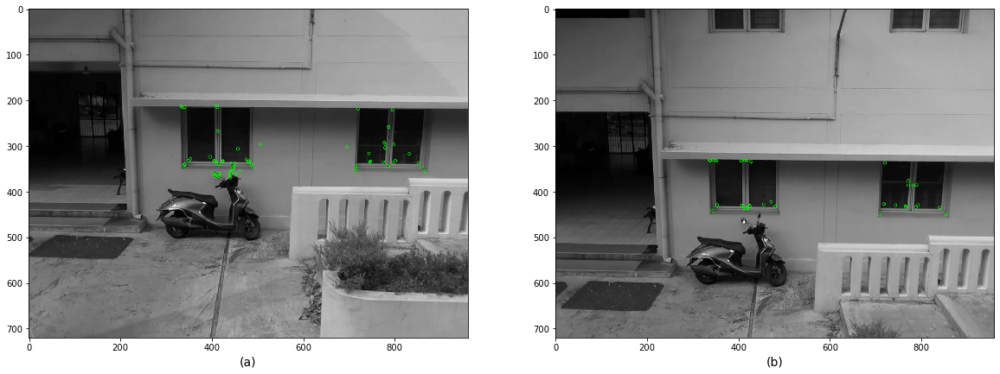

Using: bf feature matcher
Raw matches (Brute force): 27


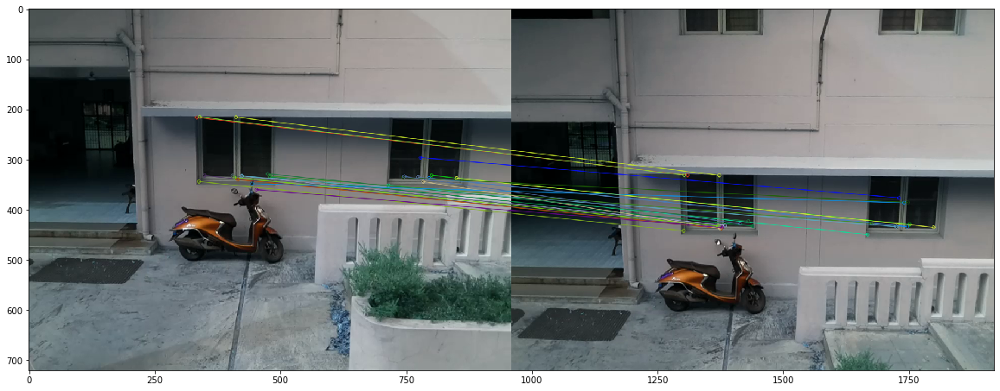

Final homography:  [[ 9.61605532e-01 -1.11751216e-01  2.92926323e+01]
 [ 2.20510762e-02  7.22411638e-01  1.57032020e+02]
 [ 5.96825441e-05 -2.46694311e-04  1.00000000e+00]]
Final inliers count:  17
Inliers: [matrix([[801.23907471, 331.50311279, 791.65753174, 429.24636841]]), matrix([[423.59313965, 333.23022461, 424.60635376, 430.96331787]]), matrix([[338.58999634, 343.72982788, 342.32946777, 441.92745972]]), matrix([[715.6395874 , 350.91738892, 708.06689453, 449.09957886]]), matrix([[423.59313965, 333.23022461, 424.60635376, 430.96331787]]), matrix([[480.49151611, 334.49819946, 479.7880249 , 432.56274414]]), matrix([[405.03436279, 332.11956787, 406.90826416, 430.28317261]]), matrix([[480.49151611, 334.49819946, 479.7880249 , 432.56274414]]), matrix([[850.92907715, 336.75024414, 839.59222412, 434.78140259]]), matrix([[405.03436279, 332.11956787, 406.90826416, 430.28317261]]), matrix([[795.97589111, 336.5413208 , 786.85827637, 433.52197266]]), matrix([[349.65612793, 331.77441406, 352.555

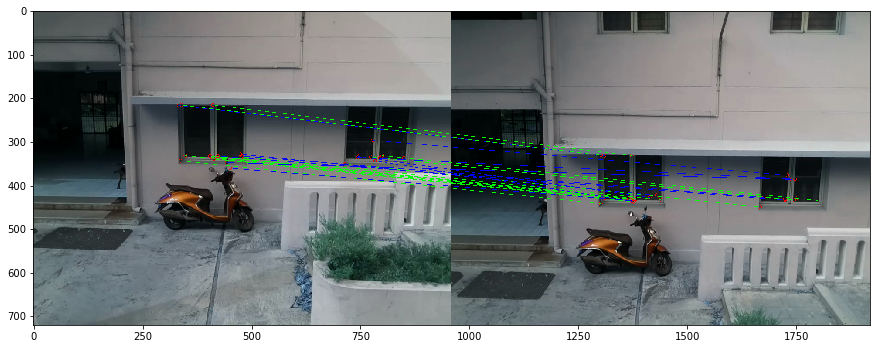

pick1: [[319, 207, 512, 365], [700, 202, 878, 362]]
pick2: [[710, 342, 855, 450], [337, 335, 482, 440]]
box2:  [710, 342, 855, 450]
pointB:  (791, 429)
listA:  []
ElementA:  [700, 202, 878, 362]
count:  0
oldBox
newCountInItr: 0
box2:  [337, 335, 482, 440]
pointB:  (791, 429)
listA:  [[700, 202, 878, 362]]
ElementA:  [700, 202, 878, 362]
count:  1
pointB:  (424, 430)
listA:  [[700, 202, 878, 362]]
ElementA:  [319, 207, 512, 365]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


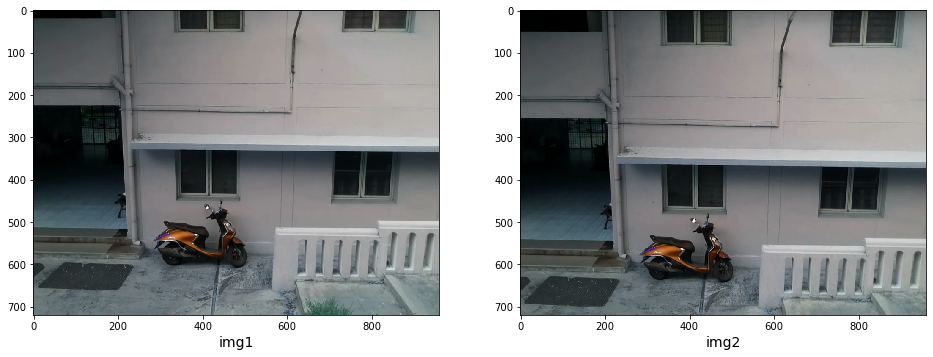

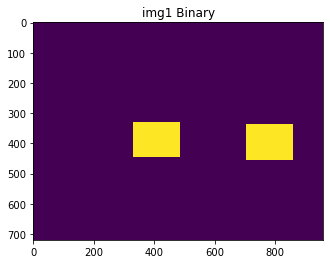

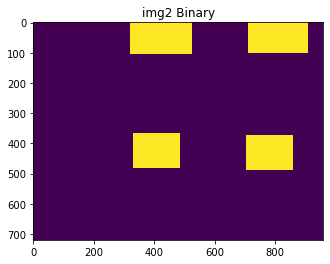

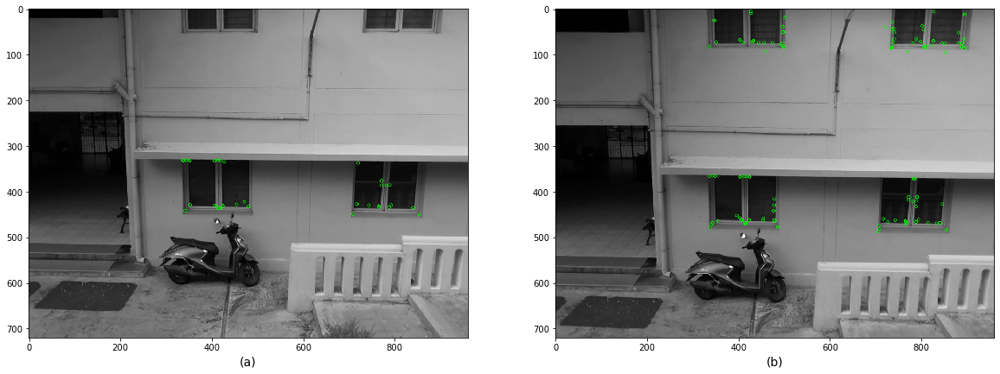

Using: bf feature matcher
Raw matches (Brute force): 35


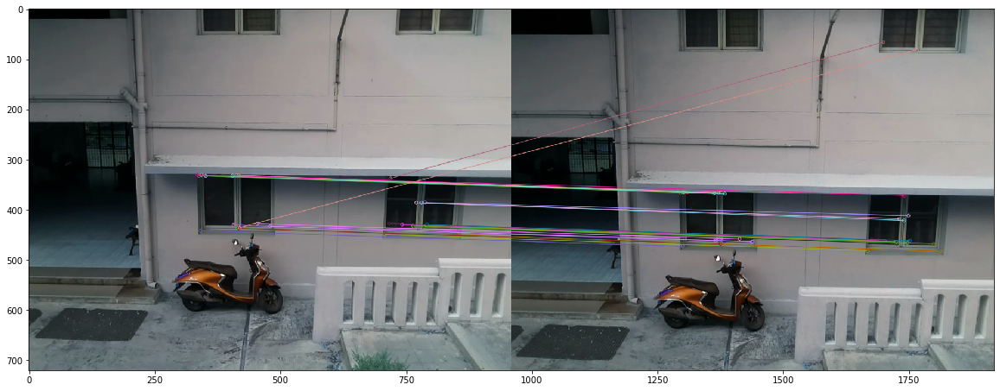

Final homography:  [[ 1.37690150e+00  6.01410037e-01 -2.81469746e+02]
 [ 2.43697718e-02  1.75994742e+00 -1.53688550e+02]
 [ 3.99087276e-05  7.32953697e-04  1.00000000e+00]]
Final inliers count:  24
Inliers: [matrix([[716.8838501 , 427.00576782, 716.39569092, 459.46353149]]), matrix([[853.24102783, 449.91021729, 853.44384766, 483.14691162]]), matrix([[742.71411133, 429.6892395 , 741.86260986, 462.0871582 ]]), matrix([[853.24102783, 449.91021729, 853.44384766, 483.14691162]]), matrix([[708.06689453, 449.09957886, 707.70898438, 481.7097168 ]]), matrix([[424.60635376, 430.96331787, 423.44238281, 461.99523926]]), matrix([[424.60635376, 430.96331787, 423.44238281, 461.99523926]]), matrix([[342.32946777, 441.92745972, 340.66430664, 472.81338501]]), matrix([[839.59222412, 434.78140259, 839.76983643, 467.72399902]]), matrix([[839.59222412, 434.78140259, 839.76983643, 467.72399902]]), matrix([[764.22698975, 431.48220825, 764.22174072, 463.82150269]]), matrix([[791.65753174, 429.24636841, 792.384

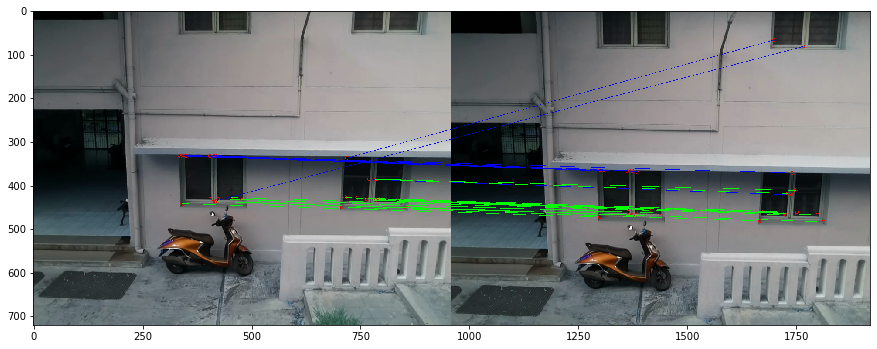

pick1: [[710, 342, 855, 450], [337, 335, 482, 440]]
pick2: [[710, 377, 857, 485], [337, 370, 482, 477], [326, 0, 521, 102], [716, 0, 906, 97]]
box2:  [710, 377, 857, 485]
pointB:  (716, 459)
listA:  []
ElementA:  [710, 342, 855, 450]
count:  0
oldBox
newCountInItr: 0
box2:  [337, 370, 482, 477]
pointB:  (716, 459)
listA:  [[710, 342, 855, 450]]
ElementA:  [710, 342, 855, 450]
count:  1
pointB:  (853, 483)
listA:  [[710, 342, 855, 450]]
ElementA:  [710, 342, 855, 450]
count:  1
pointB:  (741, 462)
listA:  [[710, 342, 855, 450]]
ElementA:  [710, 342, 855, 450]
count:  1
pointB:  (853, 483)
listA:  [[710, 342, 855, 450]]
ElementA:  [710, 342, 855, 450]
count:  1
pointB:  (707, 481)
listA:  [[710, 342, 855, 450]]
ElementA:  None
count:  0
pointB:  (423, 461)
listA:  [[710, 342, 855, 450]]
ElementA:  [337, 335, 482, 440]
count:  0
oldBox
newCountInItr: 0
box2:  [326, 0, 521, 102]
pointB:  (716, 459)
listA:  [[710, 342, 855, 450], [337, 335, 482, 440]]
ElementA:  [710, 342, 855, 450]
count: 

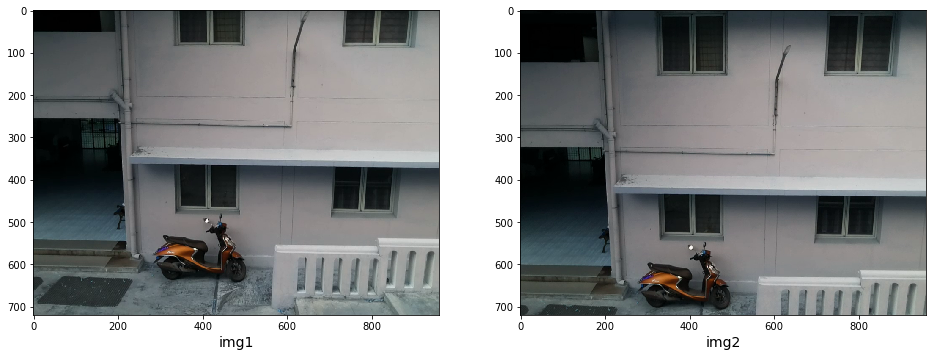

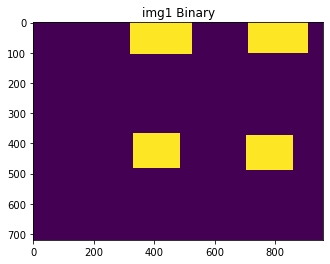

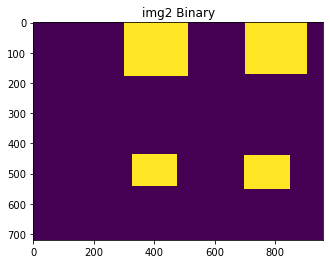

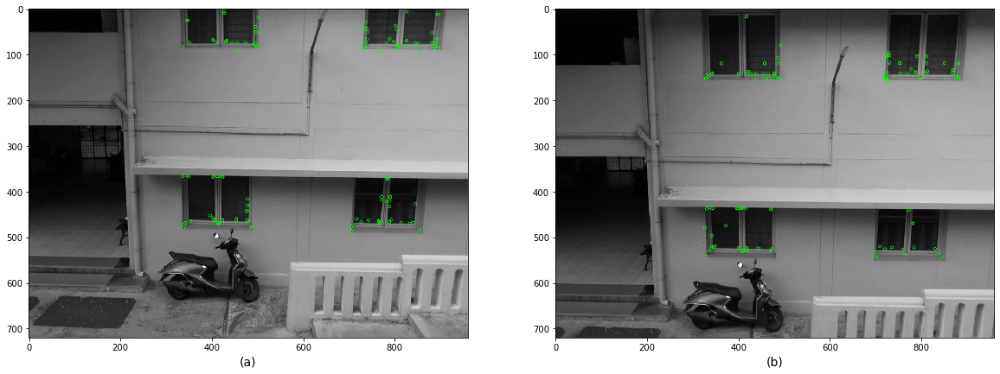

Using: bf feature matcher
Raw matches (Brute force): 86


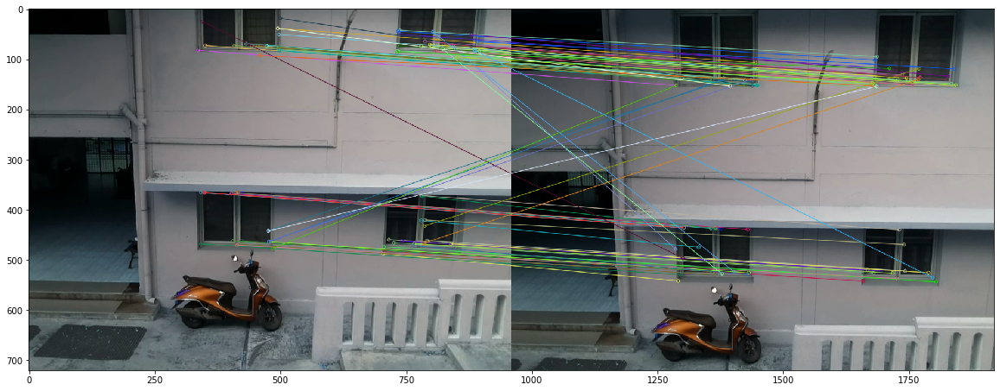

Final homography:  [[ 1.01431540e+00 -2.63762307e-03 -1.41818822e+01]
 [-6.87546757e-04  9.85634728e-01  6.98931922e+01]
 [ 1.58773223e-05 -1.46646031e-05  1.00000000e+00]]
Final inliers count:  48
Inliers: [matrix([[716.39569092, 459.46353149, 707.91235352, 519.45697021]]), matrix([[497.82556152,  51.05315018, 487.14981079, 119.01903534]]), matrix([[741.86260986, 462.0871582 , 734.15112305, 521.65753174]]), matrix([[788.14874268,  64.86513519, 776.61462402, 131.6368103 ]]), matrix([[853.44384766, 483.14691162, 844.31317139, 543.30157471]]), matrix([[432.29626465,  69.41265106, 422.32800293, 137.38725281]]), matrix([[423.44238281, 461.99523926, 416.63449097, 523.50512695]]), matrix([[736.00921631,  73.28825378, 724.48272705, 140.13560486]]), matrix([[423.44238281, 461.99523926, 416.63449097, 523.50512695]]), matrix([[495.37231445,  38.79115295, 484.97930908, 107.0190506 ]]), matrix([[443.74932861,  73.71044922, 434.36584473, 141.71395874]]), matrix([[432.29626465,  69.41265106, 422.328

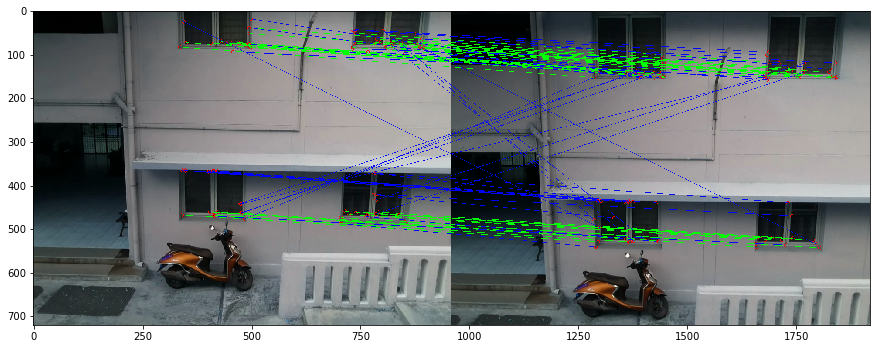

pick1: [[710, 377, 857, 485], [337, 370, 482, 477], [326, 0, 521, 102], [716, 0, 906, 97]]
pick2: [[702, 445, 845, 545], [332, 440, 472, 537], [307, 0, 507, 172], [707, 0, 902, 167]]
box2:  [702, 445, 845, 545]
pointB:  (707, 519)
listA:  []
ElementA:  [710, 377, 857, 485]
count:  0
oldBox
newCountInItr: 0
box2:  [332, 440, 472, 537]
pointB:  (707, 519)
listA:  [[710, 377, 857, 485]]
ElementA:  [710, 377, 857, 485]
count:  1
pointB:  (487, 119)
listA:  [[710, 377, 857, 485]]
ElementA:  [326, 0, 521, 102]
count:  0
pointB:  (734, 521)
listA:  [[710, 377, 857, 485]]
ElementA:  [710, 377, 857, 485]
count:  1
pointB:  (776, 131)
listA:  [[710, 377, 857, 485]]
ElementA:  [716, 0, 906, 97]
count:  0
pointB:  (844, 543)
listA:  [[710, 377, 857, 485]]
ElementA:  [710, 377, 857, 485]
count:  1
pointB:  (422, 137)
listA:  [[710, 377, 857, 485]]
ElementA:  [326, 0, 521, 102]
count:  0
pointB:  (416, 523)
listA:  [[710, 377, 857, 485]]
ElementA:  [337, 370, 482, 477]
count:  0
oldBox
newCountInItr

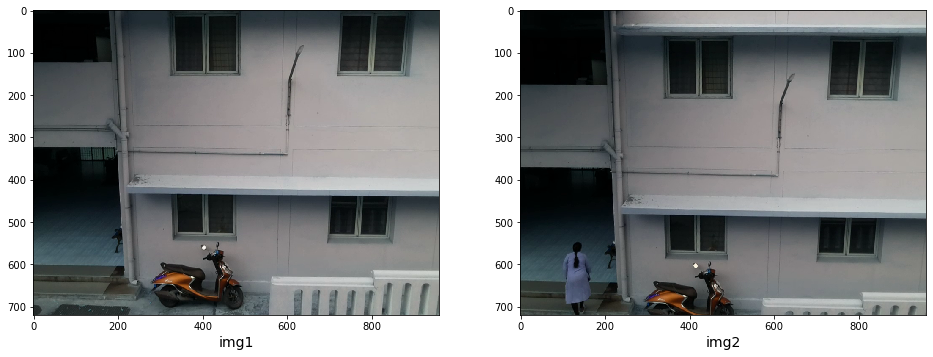

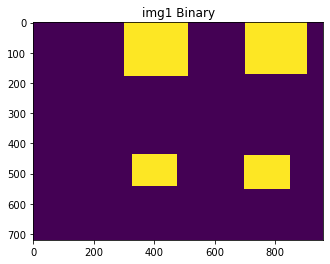

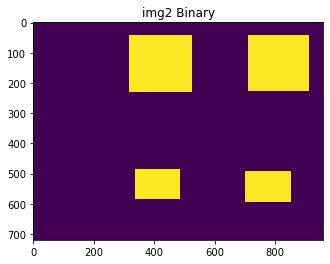

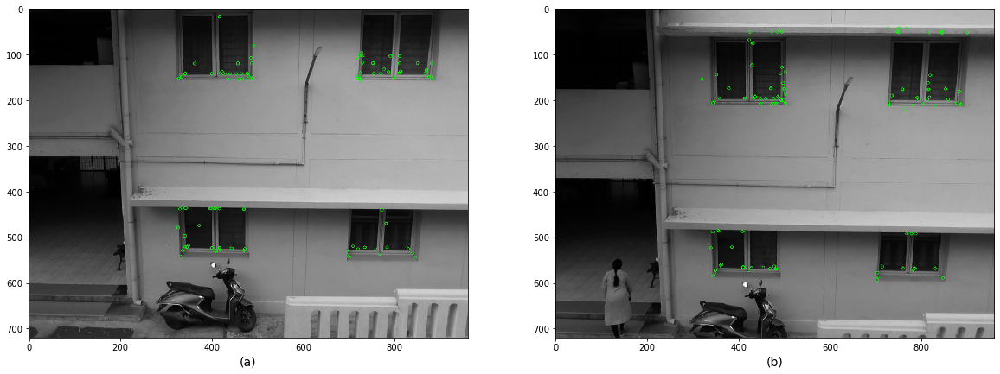

Using: bf feature matcher
Raw matches (Brute force): 82


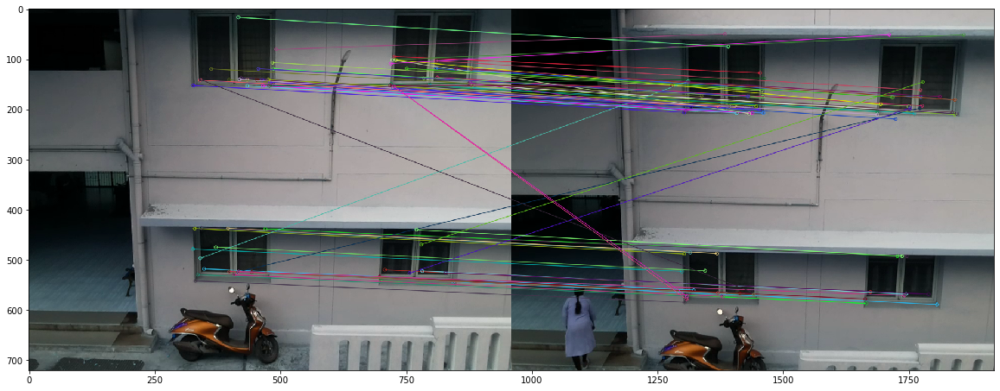

Final homography:  [[ 9.96978235e-01 -6.21601181e-03  1.91738101e+01]
 [ 8.99738935e-03  9.80039765e-01  5.47340503e+01]
 [ 1.81919755e-05  1.69587718e-06  1.00000000e+00]]
Final inliers count:  56
Inliers: [matrix([[812.57611084, 136.50613403, 816.72363281, 192.92100525]]), matrix([[487.14981079, 119.01903534, 499.86877441, 174.53620911]]), matrix([[422.32800293, 137.38725281, 435.92089844, 191.66168213]]), matrix([[809.89343262, 119.04113007, 813.99450684, 175.9050293 ]]), matrix([[812.57611084, 136.50613403, 816.72363281, 192.92100525]]), matrix([[785.54504395, 137.88009644, 790.0135498 , 194.11053467]]), matrix([[844.31317139, 543.30157471, 846.29443359, 588.38464355]]), matrix([[422.32800293, 137.38725281, 435.92089844, 191.66168213]]), matrix([[707.91235352, 519.45697021, 713.72570801, 563.70794678]]), matrix([[699.75134277, 541.98345947, 705.18518066, 586.46466064]]), matrix([[342.20297241, 435.634552  , 355.54690552, 485.04083252]]), matrix([[434.36584473, 141.71395874, 446.952

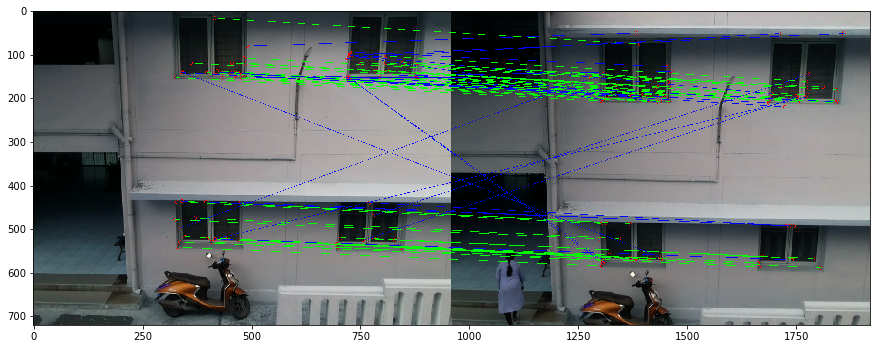

pick1: [[702, 445, 845, 545], [332, 440, 472, 537], [307, 0, 507, 172], [707, 0, 902, 167]]
pick2: [[707, 497, 850, 590], [342, 490, 482, 580], [324, 47, 521, 227], [716, 47, 908, 222]]
box2:  [707, 497, 850, 590]
pointB:  (816, 192)
listA:  []
ElementA:  [707, 0, 902, 167]
count:  0
pointB:  (499, 174)
listA:  []
ElementA:  [307, 0, 507, 172]
count:  0
pointB:  (435, 191)
listA:  []
ElementA:  [307, 0, 507, 172]
count:  0
pointB:  (813, 175)
listA:  []
ElementA:  [707, 0, 902, 167]
count:  0
pointB:  (816, 192)
listA:  []
ElementA:  [707, 0, 902, 167]
count:  0
pointB:  (790, 194)
listA:  []
ElementA:  [707, 0, 902, 167]
count:  0
pointB:  (846, 588)
listA:  []
ElementA:  [702, 445, 845, 545]
count:  0
oldBox
newCountInItr: 0
box2:  [342, 490, 482, 580]
pointB:  (816, 192)
listA:  [[702, 445, 845, 545]]
ElementA:  [707, 0, 902, 167]
count:  0
pointB:  (499, 174)
listA:  [[702, 445, 845, 545]]
ElementA:  [307, 0, 507, 172]
count:  0
pointB:  (435, 191)
listA:  [[702, 445, 845, 545]]
El

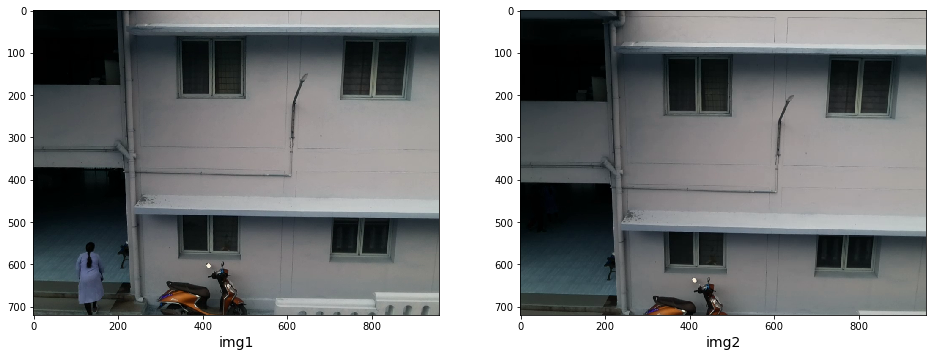

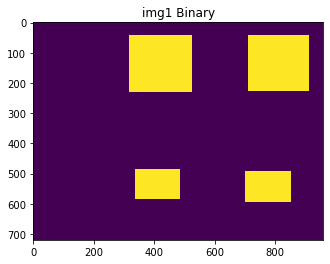

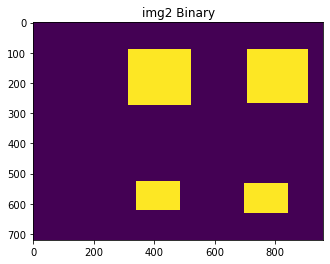

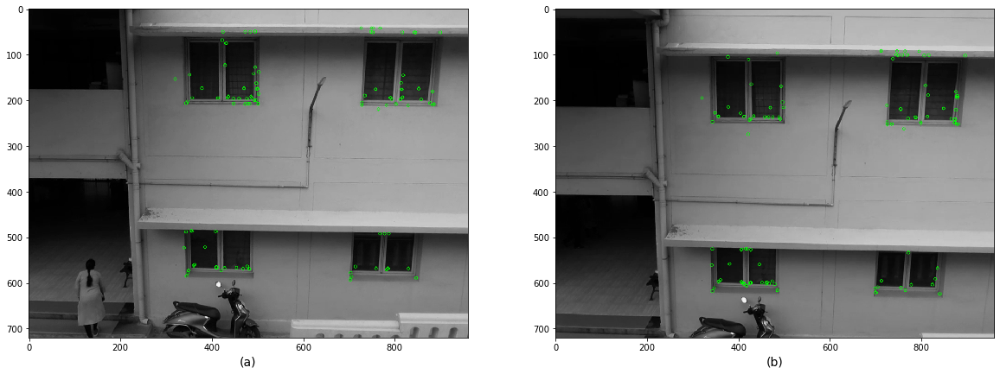

Using: bf feature matcher
Raw matches (Brute force): 79


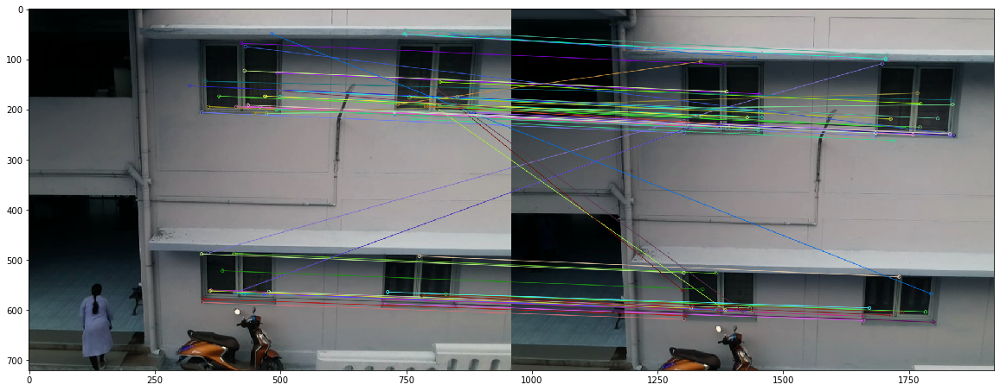

Final homography:  [[ 9.88613368e-01 -3.65440489e-03  3.49913825e+00]
 [ 1.86091705e-03  9.80903333e-01  4.30784144e+01]
 [-2.40402089e-06 -5.22496789e-08  1.00000000e+00]]
Final inliers count:  57
Inliers: [matrix([[499.86877441, 174.53620911, 498.10699463, 215.78848267]]), matrix([[764.03039551, 219.38476562, 760.57043457, 262.45852661]]), matrix([[378.28475952, 173.74311829, 377.31109619, 214.61074829]]), matrix([[470.08065796, 173.90922546, 468.97619629, 216.15803528]]), matrix([[470.08065796, 173.90922546, 468.97619629, 216.15803528]]), matrix([[319.94271851, 153.34701538, 319.98571777, 194.68804932]]), matrix([[790.0135498 , 194.11053467, 786.02886963, 236.77423096]]), matrix([[846.29443359, 588.38464355, 839.41339111, 623.49847412]]), matrix([[846.29443359, 588.38464355, 839.41339111, 623.49847412]]), matrix([[705.18518066, 586.46466064, 699.71911621, 620.72717285]]), matrix([[816.72363281, 192.92100525, 812.38812256, 235.4261322 ]]), matrix([[816.72363281, 192.92100525, 812.388

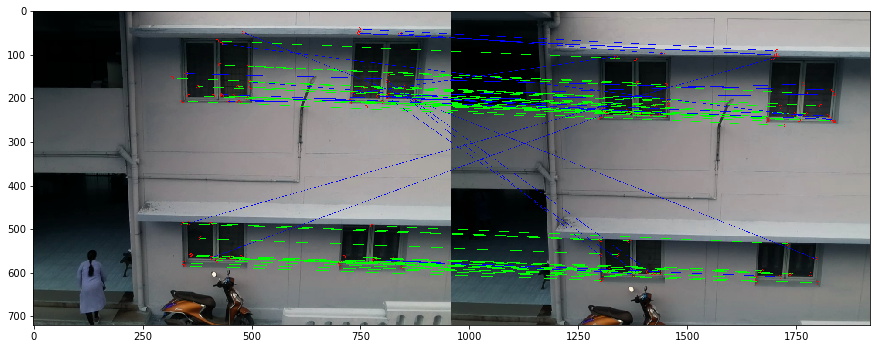

pick1: [[707, 497, 850, 590], [342, 490, 482, 580], [324, 47, 521, 227], [716, 47, 908, 222]]
pick2: [[702, 537, 840, 625], [345, 530, 482, 615], [321, 95, 518, 270], [714, 95, 904, 262]]
box2:  [702, 537, 840, 625]
pointB:  (498, 215)
listA:  []
ElementA:  [324, 47, 521, 227]
count:  0
pointB:  (760, 262)
listA:  []
ElementA:  [716, 47, 908, 222]
count:  0
pointB:  (377, 214)
listA:  []
ElementA:  [324, 47, 521, 227]
count:  0
pointB:  (468, 216)
listA:  []
ElementA:  [324, 47, 521, 227]
count:  0
pointB:  (468, 216)
listA:  []
ElementA:  [324, 47, 521, 227]
count:  0
pointB:  (319, 194)
listA:  []
ElementA:  None
count:  0
pointB:  (786, 236)
listA:  []
ElementA:  [716, 47, 908, 222]
count:  0
pointB:  (839, 623)
listA:  []
ElementA:  [707, 497, 850, 590]
count:  0
oldBox
newCountInItr: 0
box2:  [345, 530, 482, 615]
pointB:  (498, 215)
listA:  [[707, 497, 850, 590]]
ElementA:  [324, 47, 521, 227]
count:  0
pointB:  (760, 262)
listA:  [[707, 497, 850, 590]]
ElementA:  [716, 47, 908, 2

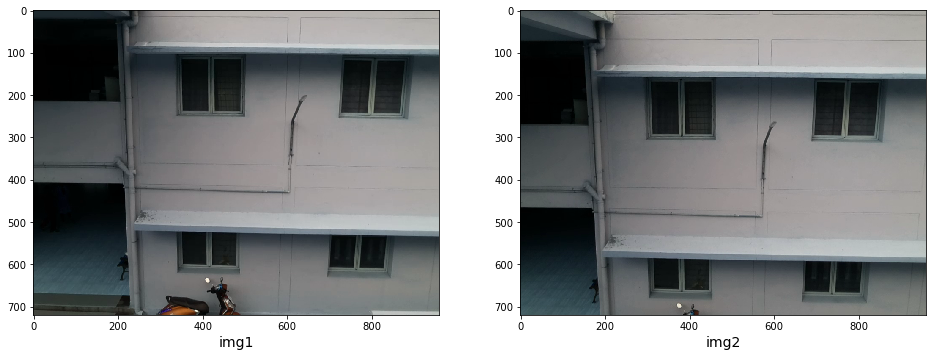

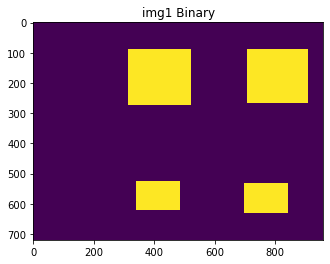

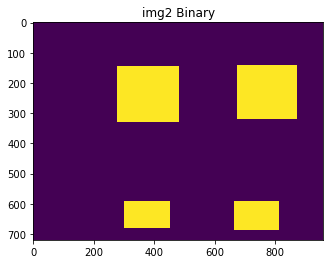

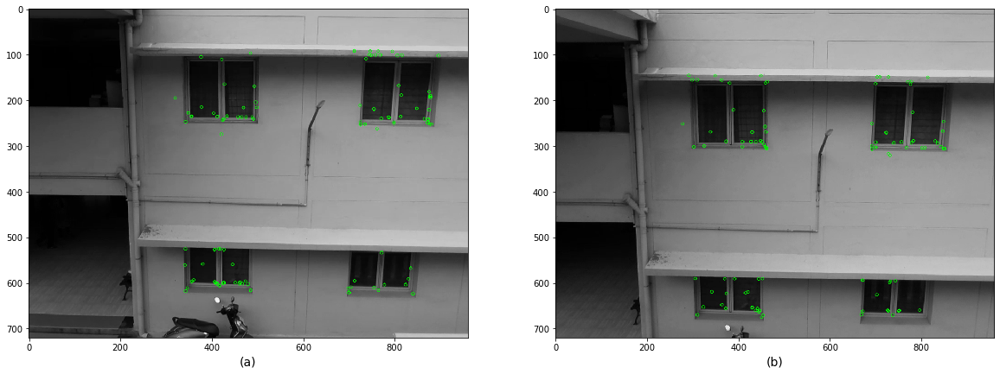

Using: bf feature matcher
Raw matches (Brute force): 73


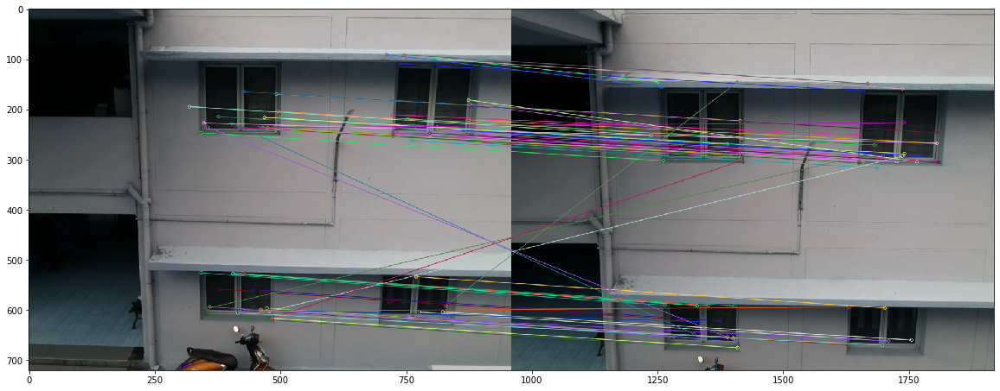

Final homography:  [[ 1.04825992e+00  1.45818028e-02 -6.04263410e+01]
 [ 8.56876155e-03  1.02400300e+00  4.73214529e+01]
 [ 2.35614096e-05  6.43517730e-07  1.00000000e+00]]
Final inliers count:  45
Inliers: [matrix([[377.31109619, 214.61074829, 338.35617065, 269.17123413]]), matrix([[468.97619629, 216.15803528, 429.52865601, 269.66918945]]), matrix([[760.57043457, 262.45852661, 727.51623535, 316.86514282]]), matrix([[468.97619629, 216.15803528, 429.52865601, 269.66918945]]), matrix([[754.00195312, 219.27224731, 722.18804932, 270.8321228 ]]), matrix([[406.58538818, 597.30773926, 371.72607422, 655.04925537]]), matrix([[411.86703491, 235.54975891, 372.77908325, 289.74996948]]), matrix([[406.58538818, 597.30773926, 371.72607422, 655.04925537]]), matrix([[465.08718872, 236.6151123 , 426.90921021, 290.4934082 ]]), matrix([[786.74975586, 237.65402222, 755.67510986, 291.0909729 ]]), matrix([[769.97766113, 239.9214325 , 738.8807373 , 293.12142944]]), matrix([[319.98571777, 194.68804932, 277.344

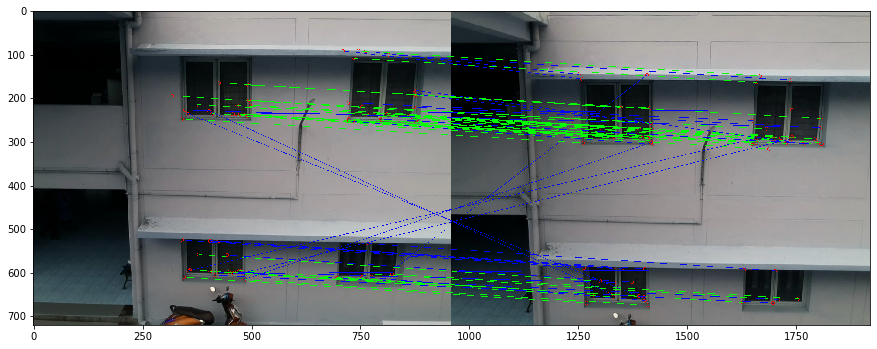

pick1: [[702, 537, 840, 625], [345, 530, 482, 615], [321, 95, 518, 270], [714, 95, 904, 262]]
pick2: [[672, 597, 810, 682], [307, 595, 450, 675], [282, 150, 477, 325], [680, 147, 870, 317]]
box2:  [672, 597, 810, 682]
pointB:  (338, 269)
listA:  []
ElementA:  [321, 95, 518, 270]
count:  0
pointB:  (429, 269)
listA:  []
ElementA:  [321, 95, 518, 270]
count:  0
pointB:  (727, 316)
listA:  []
ElementA:  [714, 95, 904, 262]
count:  0
pointB:  (429, 269)
listA:  []
ElementA:  [321, 95, 518, 270]
count:  0
pointB:  (722, 270)
listA:  []
ElementA:  [714, 95, 904, 262]
count:  0
pointB:  (371, 655)
listA:  []
ElementA:  [345, 530, 482, 615]
count:  0
pointB:  (372, 289)
listA:  []
ElementA:  [321, 95, 518, 270]
count:  0
pointB:  (371, 655)
listA:  []
ElementA:  [345, 530, 482, 615]
count:  0
pointB:  (426, 290)
listA:  []
ElementA:  [321, 95, 518, 270]
count:  0
pointB:  (755, 291)
listA:  []
ElementA:  [714, 95, 904, 262]
count:  0
pointB:  (738, 293)
listA:  []
ElementA:  [714, 95, 904, 262

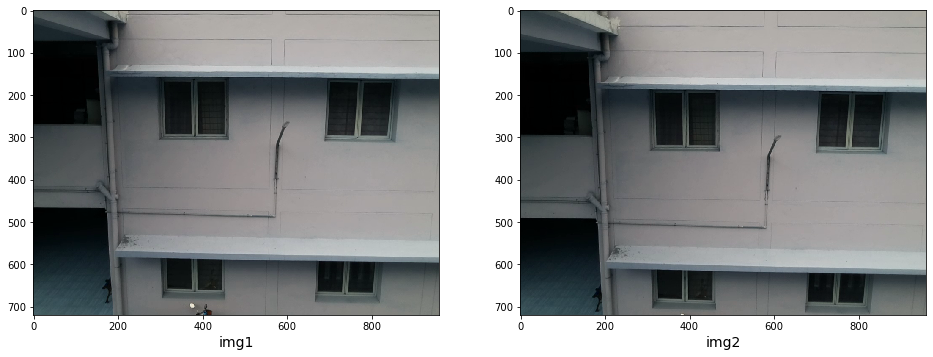

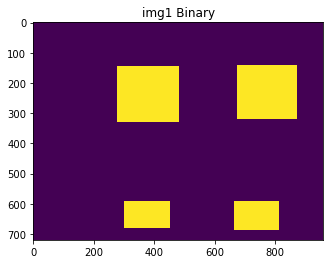

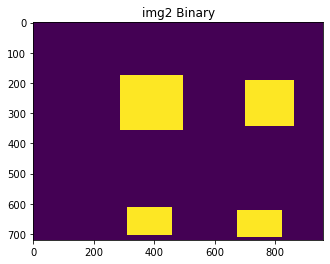

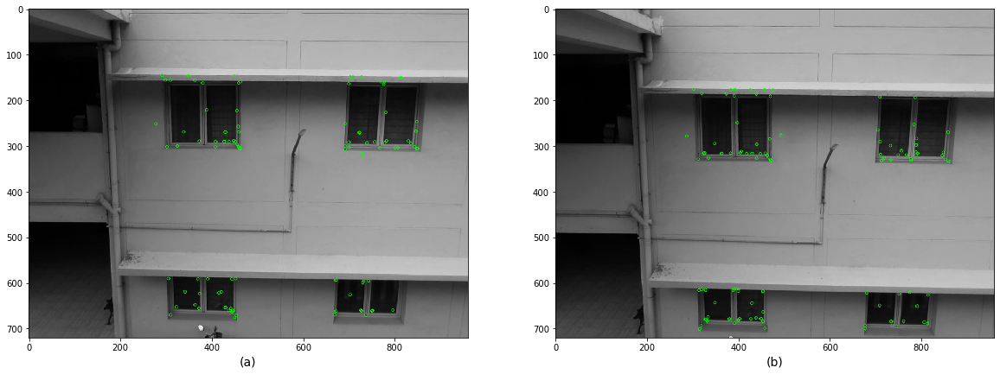

Using: bf feature matcher
Raw matches (Brute force): 82


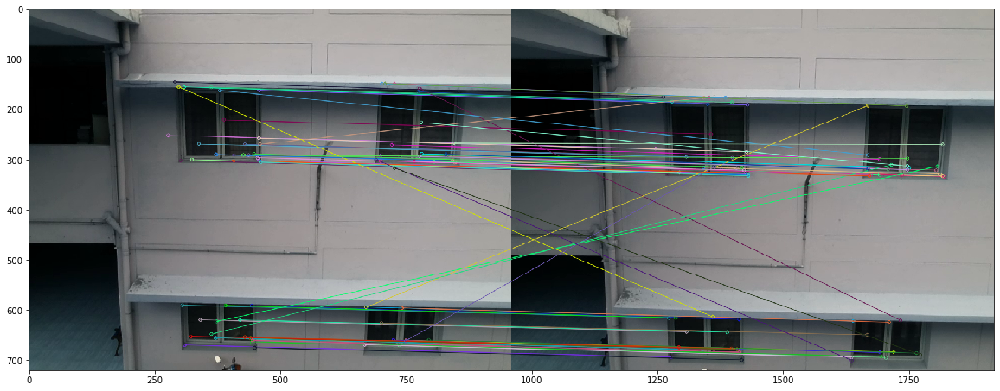

Final homography:  [[ 1.00481933e+00 -2.14511581e-03  9.08037854e+00]
 [ 3.12240560e-03  9.97990386e-01  2.64793212e+01]
 [ 2.59481254e-06  3.83593857e-06  1.00000000e+00]]
Final inliers count:  56
Inliers: [matrix([[850.37426758, 305.83724976, 860.19213867, 333.68560791]]), matrix([[309.85513306, 669.41882324, 317.9208374 , 693.18304443]]), matrix([[725.34234619, 659.45031738, 733.26879883, 683.85223389]]), matrix([[437.37423706, 290.75466919, 447.29718018, 316.76959229]]), matrix([[458.4203186 , 162.27381897, 469.01727295, 191.22335815]]), matrix([[408.42767334, 290.61328125, 417.51541138, 316.58041382]]), matrix([[429.52865601, 269.66918945, 439.22885132, 295.98556519]]), matrix([[449.70632935, 674.62109375, 457.73855591, 698.74029541]]), matrix([[338.35617065, 269.17123413, 347.54455566, 294.45611572]]), matrix([[277.34411621, 251.84283447, 286.73751831, 278.21304321]]), matrix([[834.6675415 , 293.71176147, 844.76171875, 321.12454224]]), matrix([[291.2159729 , 145.45358276, 301.906

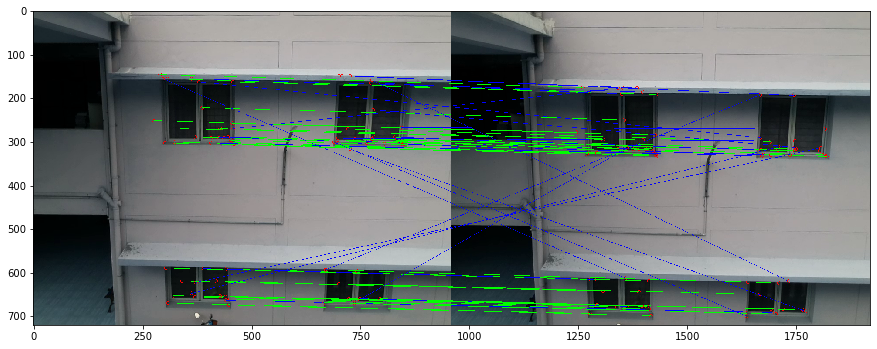

pick1: [[672, 597, 810, 682], [307, 595, 450, 675], [282, 150, 477, 325], [680, 147, 870, 317]]
pick2: [[680, 625, 820, 705], [315, 617, 455, 700], [292, 180, 492, 352], [707, 195, 860, 337]]
box2:  [680, 625, 820, 705]
pointB:  (860, 333)
listA:  []
ElementA:  [680, 147, 870, 317]
count:  0
pointB:  (317, 693)
listA:  []
ElementA:  [307, 595, 450, 675]
count:  0
pointB:  (733, 683)
listA:  []
ElementA:  [672, 597, 810, 682]
count:  0
oldBox
newCountInItr: 0
box2:  [315, 617, 455, 700]
pointB:  (860, 333)
listA:  [[672, 597, 810, 682]]
ElementA:  [680, 147, 870, 317]
count:  0
pointB:  (317, 693)
listA:  [[672, 597, 810, 682]]
ElementA:  [307, 595, 450, 675]
count:  0
oldBox
newCountInItr: 0
box2:  [292, 180, 492, 352]
pointB:  (860, 333)
listA:  [[672, 597, 810, 682], [307, 595, 450, 675]]
ElementA:  [680, 147, 870, 317]
count:  0
pointB:  (317, 693)
listA:  [[672, 597, 810, 682], [307, 595, 450, 675]]
ElementA:  [307, 595, 450, 675]
count:  1
pointB:  (733, 683)
listA:  [[672, 597, 8

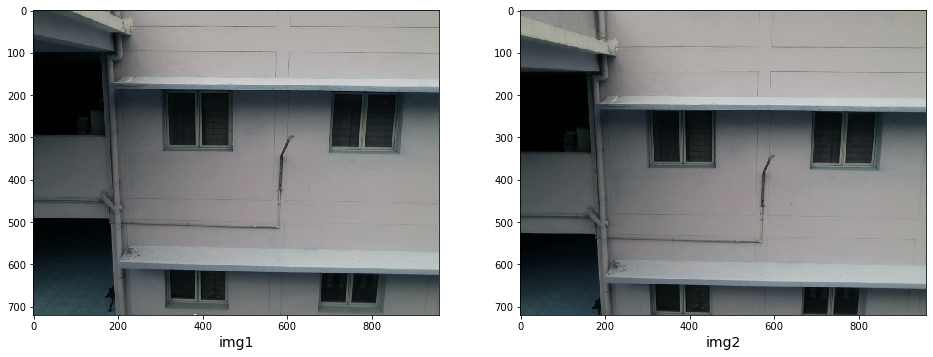

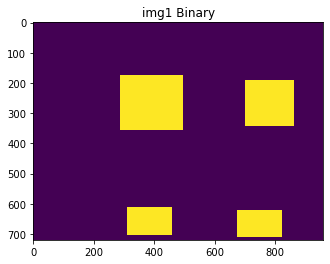

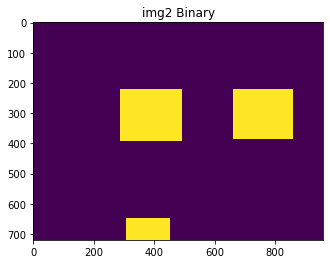

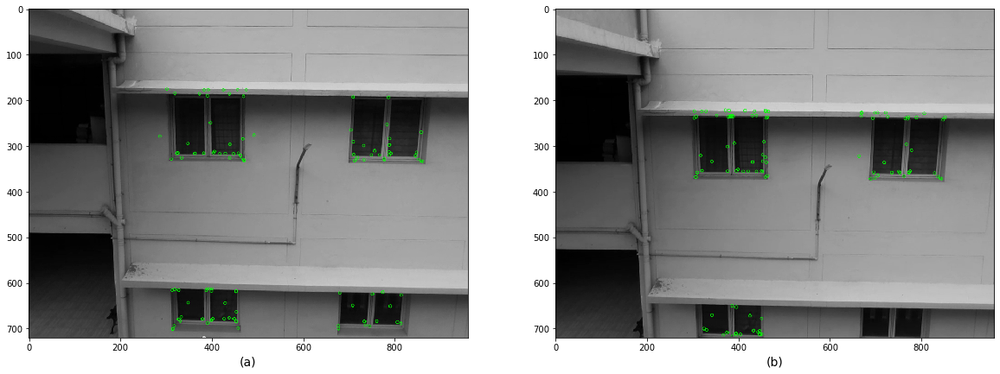

Using: bf feature matcher
Raw matches (Brute force): 71


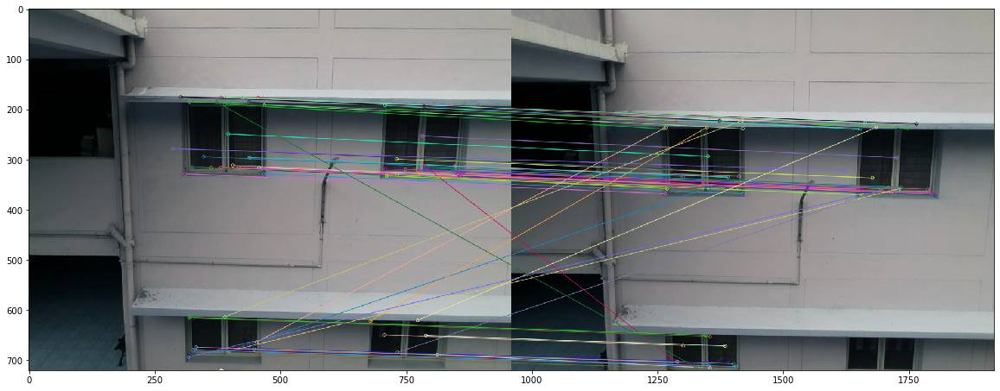

Final homography:  [[ 1.00800882e+00  3.60671731e-03 -5.31734810e+00]
 [ 1.39615669e-02  9.87109511e-01  4.23350173e+01]
 [ 2.96530775e-05  3.46559568e-06  1.00000000e+00]]
Final inliers count:  42
Inliers: [matrix([[447.29718018, 316.76959229, 438.91140747, 355.86981201]]), matrix([[844.76171875, 321.12454224, 827.8772583 , 359.24822998]]), matrix([[717.82495117, 325.58984375, 704.09136963, 364.05175781]]), matrix([[766.56488037, 319.75845337, 751.54193115, 358.12997437]]), matrix([[439.22885132, 295.98556519, 430.38638306, 335.04882812]]), matrix([[458.19430542, 315.61477661, 449.6786499 , 354.57150269]]), matrix([[467.48883057, 284.34524536, 458.66351318, 324.8815918 ]]), matrix([[439.22885132, 295.98556519, 430.38638306, 335.04882812]]), matrix([[405.8324585 , 311.77508545, 398.41497803, 351.38375854]]), matrix([[748.67718506, 319.85998535, 734.46984863, 358.19720459]]), matrix([[405.8324585 , 311.77508545, 398.41497803, 351.38375854]]), matrix([[469.01727295, 191.22335815, 460.092

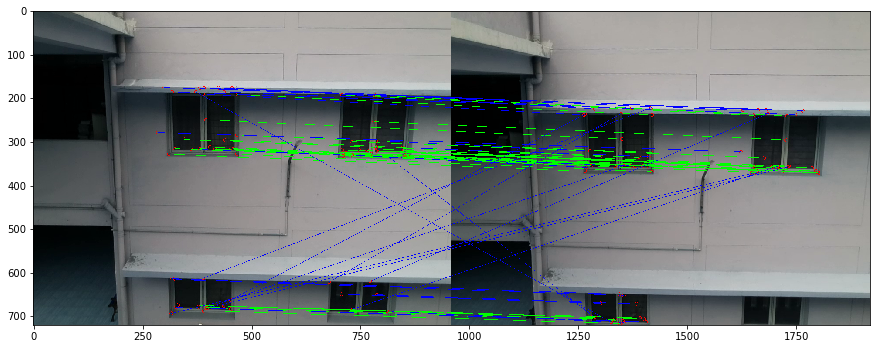

pick1: [[680, 625, 820, 705], [315, 617, 455, 700], [292, 180, 492, 352], [707, 195, 860, 337]]
pick2: [[312, 652, 447, 725], [294, 227, 489, 387], [668, 225, 856, 382]]
box2:  [312, 652, 447, 725]
pointB:  (438, 355)
listA:  []
ElementA:  [292, 180, 492, 352]
count:  0
pointB:  (827, 359)
listA:  []
ElementA:  [707, 195, 860, 337]
count:  0
pointB:  (704, 364)
listA:  []
ElementA:  [707, 195, 860, 337]
count:  0
pointB:  (751, 358)
listA:  []
ElementA:  [707, 195, 860, 337]
count:  0
pointB:  (430, 335)
listA:  []
ElementA:  [292, 180, 492, 352]
count:  0
pointB:  (449, 354)
listA:  []
ElementA:  [292, 180, 492, 352]
count:  0
pointB:  (458, 324)
listA:  []
ElementA:  [292, 180, 492, 352]
count:  0
pointB:  (430, 335)
listA:  []
ElementA:  [292, 180, 492, 352]
count:  0
pointB:  (398, 351)
listA:  []
ElementA:  [292, 180, 492, 352]
count:  0
pointB:  (734, 358)
listA:  []
ElementA:  [707, 195, 860, 337]
count:  0
pointB:  (398, 351)
listA:  []
ElementA:  [292, 180, 492, 352]
count:  0

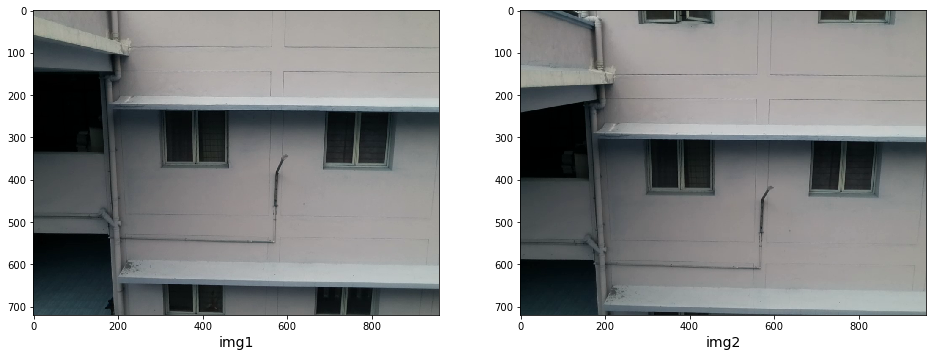

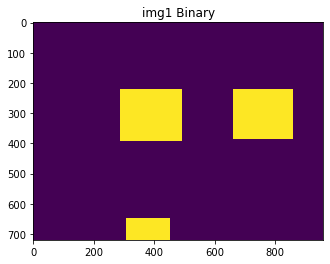

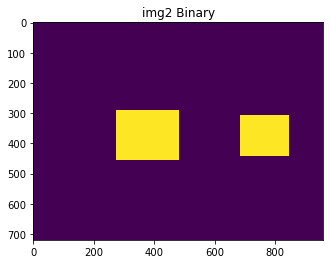

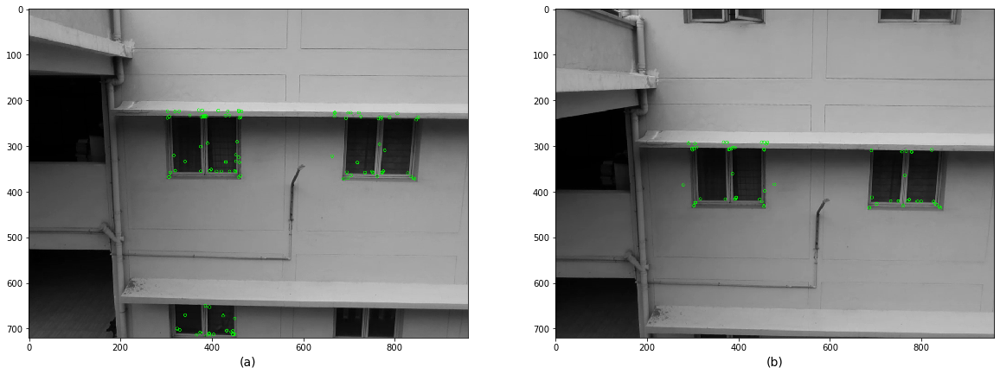

Using: bf feature matcher
Raw matches (Brute force): 49


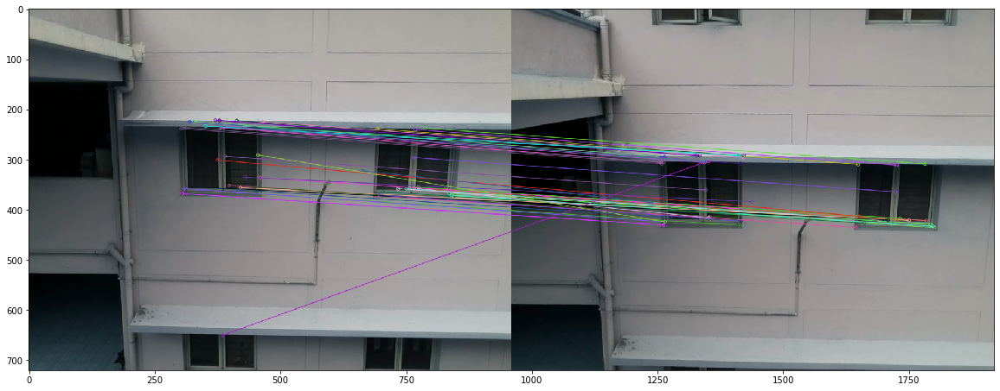

Final homography:  [[ 9.92734102e-01 -1.12885198e-02 -1.61855585e+00]
 [ 2.31665281e-03  9.07682572e-01  8.86212540e+01]
 [ 7.76435446e-07 -3.38514190e-05  1.00000000e+00]]
Final inliers count:  31
Inliers: [matrix([[774.65136719, 355.14810181, 772.61846924, 417.18566895]]), matrix([[398.41497803, 351.38375854, 394.61090088, 413.17596436]]), matrix([[303.09484863, 238.47312927, 298.76647949, 308.21682739]]), matrix([[842.99468994, 371.92825317, 840.82080078, 435.24050903]]), matrix([[827.8772583 , 359.24822998, 825.69866943, 421.47720337]]), matrix([[774.65136719, 355.14810181, 772.61846924, 417.18566895]]), matrix([[398.41497803, 351.38375854, 394.61090088, 413.17596436]]), matrix([[692.84442139, 239.03846741, 689.6572876 , 309.65869141]]), matrix([[460.33383179, 336.0642395 , 456.66482544, 398.00354004]]), matrix([[459.1947937 , 368.15512085, 455.27816772, 431.31982422]]), matrix([[379.08135986, 222.20875549, 374.42651367, 292.13217163]]), matrix([[704.09136963, 364.05175781, 701.457

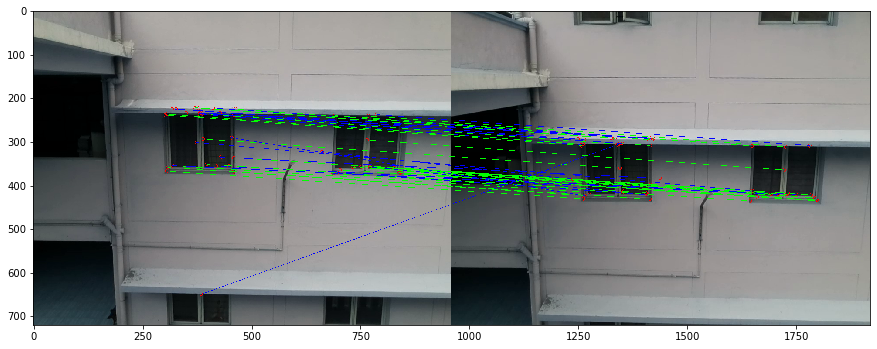

pick1: [[312, 652, 447, 725], [294, 227, 489, 387], [668, 225, 856, 382]]
pick2: [[281, 297, 478, 452], [690, 312, 842, 437]]
box2:  [281, 297, 478, 452]
pointB:  (772, 417)
listA:  []
ElementA:  [668, 225, 856, 382]
count:  0
pointB:  (394, 413)
listA:  []
ElementA:  [294, 227, 489, 387]
count:  0
oldBox
newCountInItr: 0
box2:  [690, 312, 842, 437]
pointB:  (772, 417)
listA:  [[294, 227, 489, 387]]
ElementA:  [668, 225, 856, 382]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


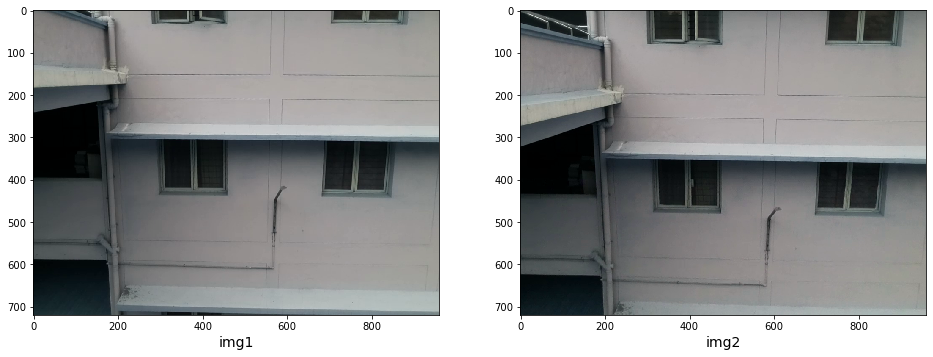

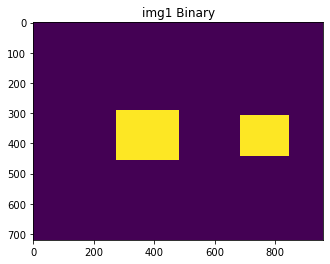

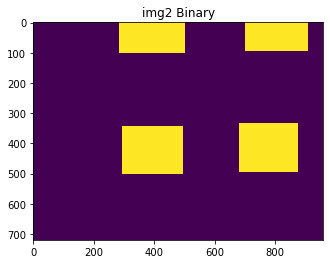

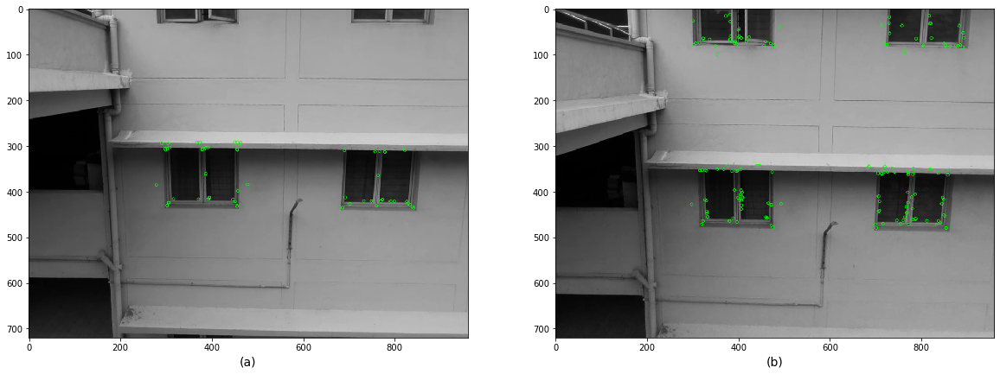

Using: bf feature matcher
Raw matches (Brute force): 58


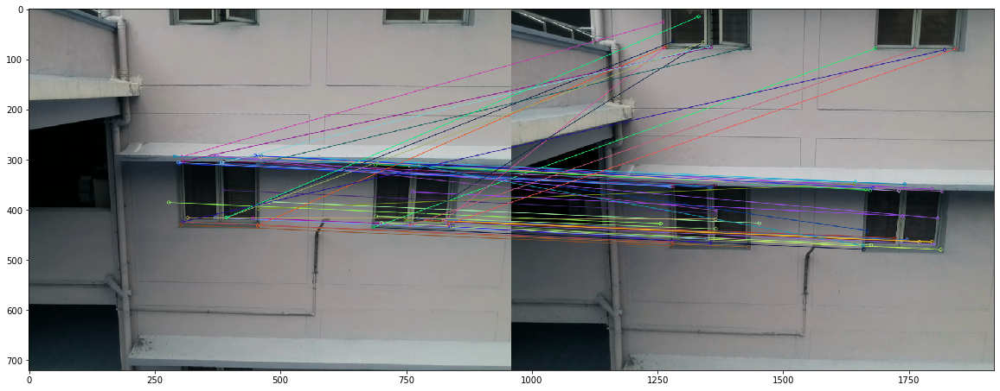

Final homography:  [[ 9.68421758e-01 -9.00102397e-03  2.88757106e+01]
 [-2.51268108e-03  9.20853337e-01  7.17098986e+01]
 [-1.98901509e-05 -3.66890824e-06  1.00000000e+00]]
Final inliers count:  27
Inliers: [matrix([[756.59747314, 312.1685791 , 770.68933105, 362.42651367]]), matrix([[455.27816772, 431.31982422, 471.20724487, 473.95135498]]), matrix([[378.85882568, 307.36624146, 395.51293945, 355.22738647]]), matrix([[445.98754883, 416.35339355, 461.60290527, 458.0112915 ]]), matrix([[701.45751953, 426.48571777, 715.44506836, 469.97061157]]), matrix([[798.77471924, 421.19204712, 811.13909912, 463.84820557]]), matrix([[689.6572876 , 309.65869141, 704.39337158, 359.64935303]]), matrix([[478.0793457 , 383.92202759, 492.79046631, 426.66253662]]), matrix([[278.40405273, 385.37695312, 297.11978149, 427.6678772 ]]), matrix([[380.37536621, 306.48724365, 397.61288452, 353.98846436]]), matrix([[840.82080078, 435.24050903, 853.2855835 , 479.18209839]]), matrix([[685.56030273, 435.04275513, 700.346

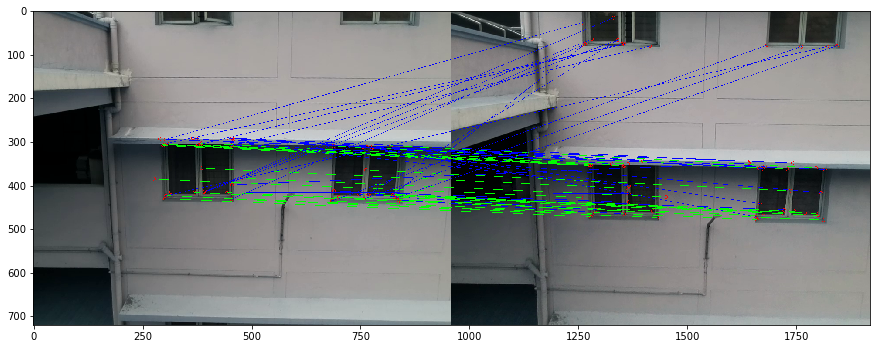

pick1: [[281, 297, 478, 452], [690, 312, 842, 437]]
pick2: [[300, 347, 492, 497], [687, 340, 872, 490], [291, 0, 498, 97], [706, 0, 904, 92]]
box2:  [300, 347, 492, 497]
pointB:  (770, 362)
listA:  []
ElementA:  [690, 312, 842, 437]
count:  0
pointB:  (471, 473)
listA:  []
ElementA:  [281, 297, 478, 452]
count:  0
oldBox
newCountInItr: 0
box2:  [687, 340, 872, 490]
pointB:  (770, 362)
listA:  [[281, 297, 478, 452]]
ElementA:  [690, 312, 842, 437]
count:  0
oldBox
newCountInItr: 0
box2:  [291, 0, 498, 97]
pointB:  (770, 362)
listA:  [[281, 297, 478, 452], [690, 312, 842, 437]]
ElementA:  [690, 312, 842, 437]
count:  1
pointB:  (471, 473)
listA:  [[281, 297, 478, 452], [690, 312, 842, 437]]
ElementA:  [281, 297, 478, 452]
count:  1
pointB:  (395, 355)
listA:  [[281, 297, 478, 452], [690, 312, 842, 437]]
ElementA:  [281, 297, 478, 452]
count:  1
pointB:  (461, 458)
listA:  [[281, 297, 478, 452], [690, 312, 842, 437]]
ElementA:  [281, 297, 478, 452]
count:  1
pointB:  (715, 469)
listA:  [[

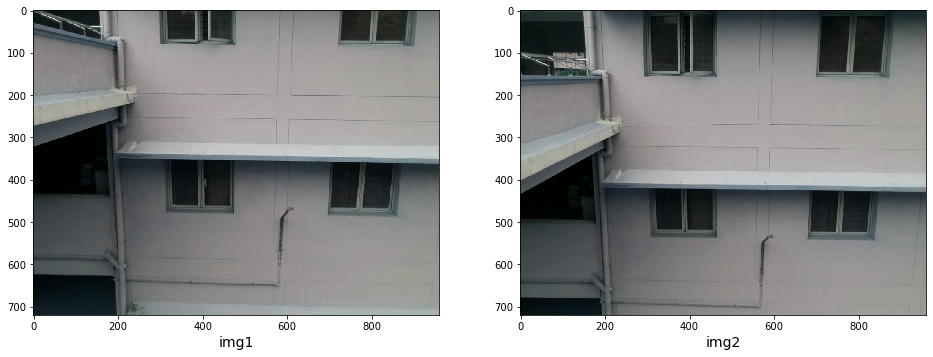

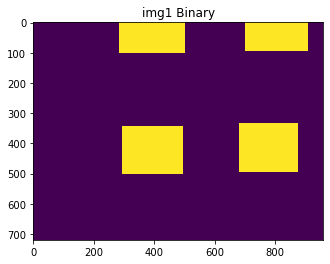

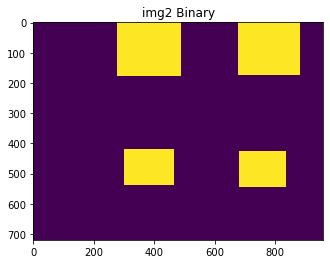

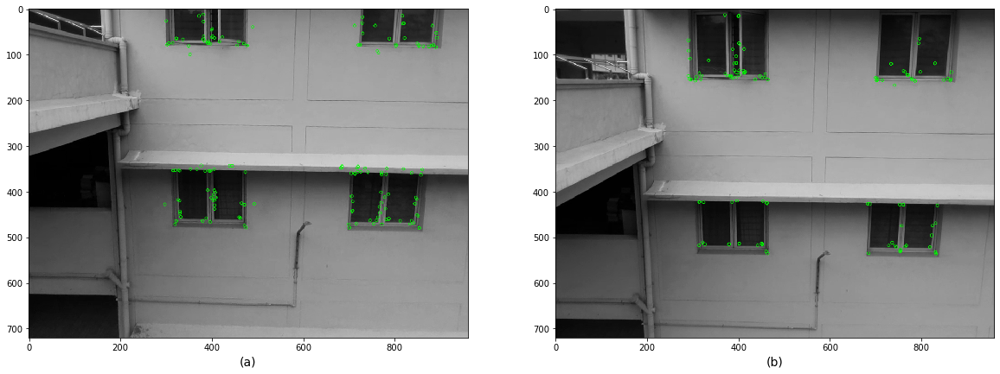

Using: bf feature matcher
Raw matches (Brute force): 82


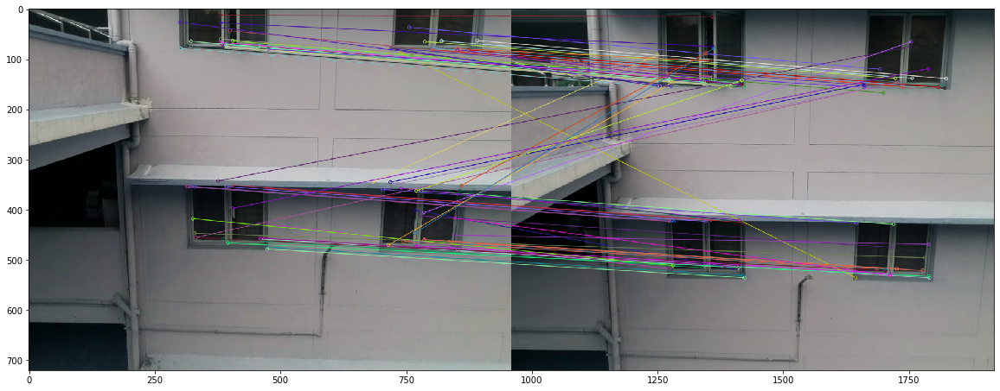

Final homography:  [[ 9.63472228e-01 -6.83715070e-03  4.23554796e+00]
 [-9.75890687e-04  9.39480184e-01  7.90078428e+01]
 [ 2.72225272e-07 -2.84568610e-05  1.00000000e+00]]
Final inliers count:  41
Inliers: [matrix([[820.92663574,  63.98319626, 796.60809326, 137.94779968]]), matrix([[461.60290527, 458.0112915 , 451.59860229, 515.39453125]]), matrix([[461.60290527, 458.0112915 , 451.59860229, 515.39453125]]), matrix([[853.2855835 , 479.18209839, 831.43902588, 535.48077393]]), matrix([[853.2855835 , 479.18209839, 831.43902588, 535.48077393]]), matrix([[459.68661499, 455.80996704, 449.79232788, 513.37841797]]), matrix([[459.68661499, 455.80996704, 449.79232788, 513.37841797]]), matrix([[787.65484619,  65.1124115 , 763.58648682, 138.17752075]]), matrix([[761.59686279,  91.96508789, 740.22338867, 167.11192322]]), matrix([[469.49209595,  75.69637299, 457.42007446, 150.31488037]]), matrix([[384.88394165,  70.73639679, 375.23553467, 145.96891785]]), matrix([[802.05566406,  81.2735672 , 778.448

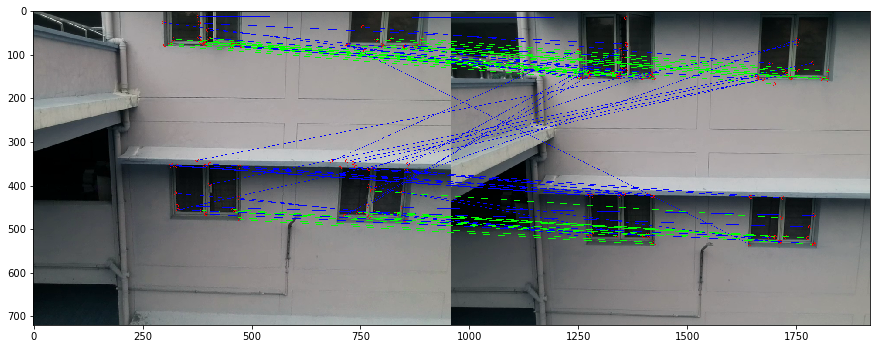

pick1: [[300, 347, 492, 497], [687, 340, 872, 490], [291, 0, 498, 97], [706, 0, 904, 92]]
pick2: [[687, 432, 832, 540], [307, 425, 462, 535], [283, 0, 486, 172], [684, 0, 879, 170]]
box2:  [687, 432, 832, 540]
pointB:  (796, 137)
listA:  []
ElementA:  [706, 0, 904, 92]
count:  0
pointB:  (451, 515)
listA:  []
ElementA:  [300, 347, 492, 497]
count:  0
pointB:  (451, 515)
listA:  []
ElementA:  [300, 347, 492, 497]
count:  0
pointB:  (831, 535)
listA:  []
ElementA:  [687, 340, 872, 490]
count:  0
oldBox
newCountInItr: 0
box2:  [307, 425, 462, 535]
pointB:  (796, 137)
listA:  [[687, 340, 872, 490]]
ElementA:  [706, 0, 904, 92]
count:  0
pointB:  (451, 515)
listA:  [[687, 340, 872, 490]]
ElementA:  [300, 347, 492, 497]
count:  0
oldBox
newCountInItr: 0
box2:  [283, 0, 486, 172]
pointB:  (796, 137)
listA:  [[687, 340, 872, 490], [300, 347, 492, 497]]
ElementA:  [706, 0, 904, 92]
count:  0
pointB:  (451, 515)
listA:  [[687, 340, 872, 490], [300, 347, 492, 497]]
ElementA:  [300, 347, 492, 497]

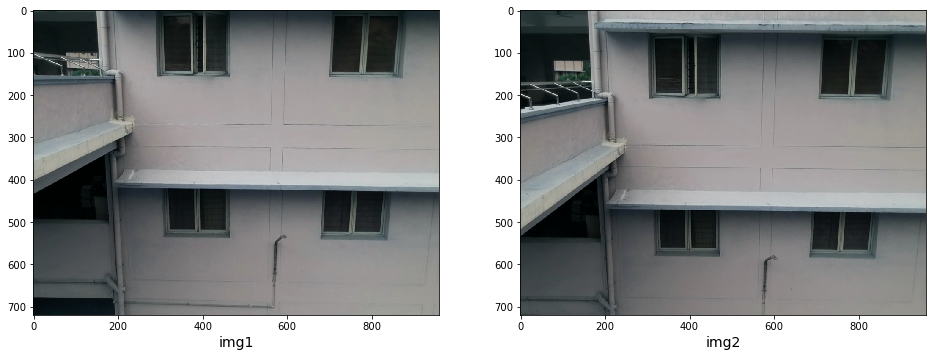

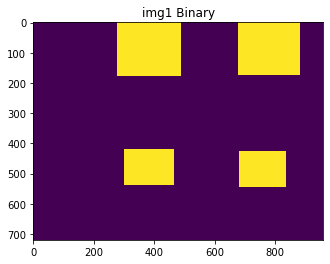

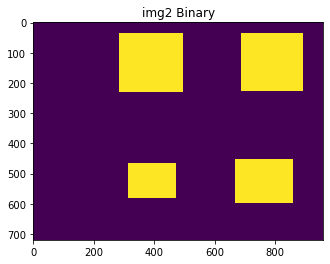

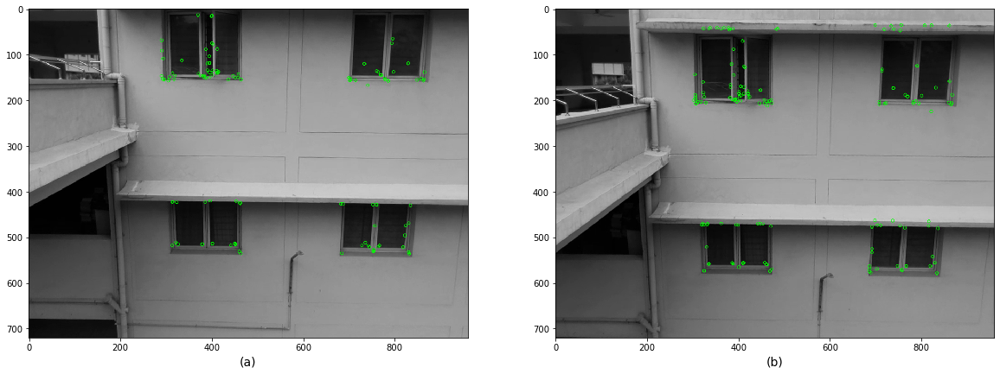

Using: bf feature matcher
Raw matches (Brute force): 93


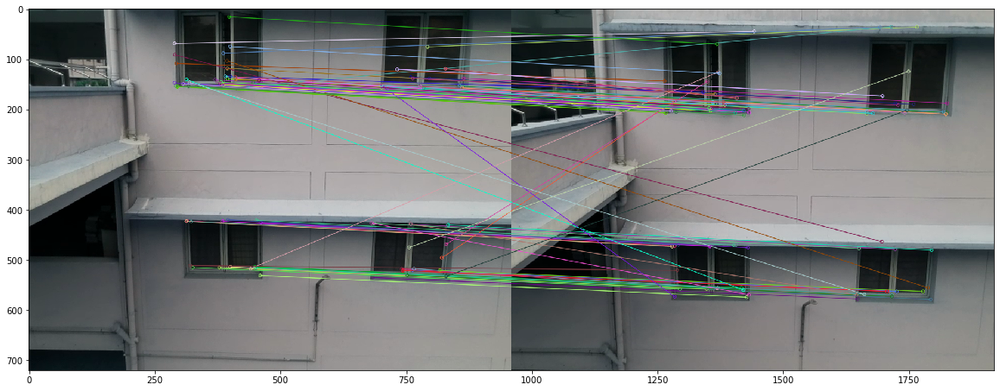

Final homography:  [[ 9.66864048e-01 -4.09955589e-03  1.95640830e+01]
 [-2.50654971e-03  9.60982725e-01  5.71275631e+01]
 [-1.43091186e-05 -8.54046805e-06  1.00000000e+00]]
Final inliers count:  59
Inliers: [matrix([[759.94506836, 135.93395996, 763.73706055, 187.99572754]]), matrix([[796.60809326, 137.94779968, 799.94915771, 190.07150269]]), matrix([[831.43902588, 535.48077393, 833.28894043, 578.43249512]]), matrix([[831.43902588, 535.48077393, 833.28894043, 578.43249512]]), matrix([[460.24551392, 530.74755859, 468.02185059, 574.03625488]]), matrix([[863.3182373 , 153.95359802, 865.50274658, 206.44111633]]), matrix([[457.42007446, 150.31488037, 466.55218506, 202.27966309]]), matrix([[683.76062012, 534.68817139, 688.35388184, 577.52758789]]), matrix([[763.33966064, 520.09350586, 766.21356201, 562.56323242]]), matrix([[449.79232788, 513.37841797, 457.29571533, 555.35723877]]), matrix([[394.775177  , 118.45548248, 404.51217651, 169.50810242]]), matrix([[759.89031982, 428.81518555, 762.831

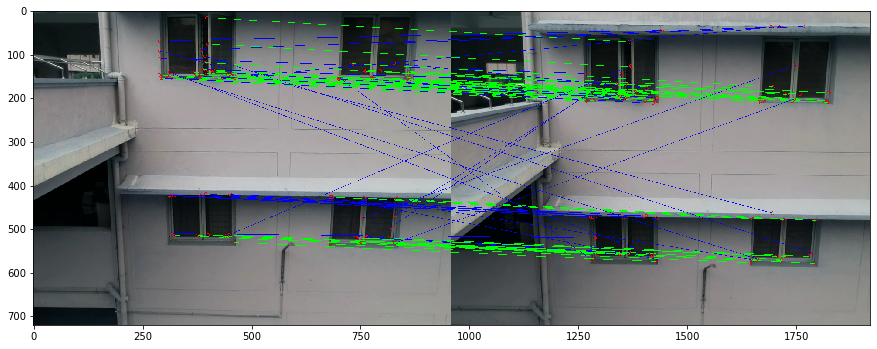

pick1: [[687, 432, 832, 540], [307, 425, 462, 535], [283, 0, 486, 172], [684, 0, 879, 170]]
pick2: [[674, 457, 856, 592], [320, 472, 470, 577], [289, 42, 492, 225], [693, 40, 890, 222]]
box2:  [674, 457, 856, 592]
pointB:  (763, 187)
listA:  []
ElementA:  [684, 0, 879, 170]
count:  0
pointB:  (799, 190)
listA:  []
ElementA:  [684, 0, 879, 170]
count:  0
pointB:  (833, 578)
listA:  []
ElementA:  [687, 432, 832, 540]
count:  0
oldBox
newCountInItr: 0
box2:  [320, 472, 470, 577]
pointB:  (763, 187)
listA:  [[687, 432, 832, 540]]
ElementA:  [684, 0, 879, 170]
count:  0
pointB:  (799, 190)
listA:  [[687, 432, 832, 540]]
ElementA:  [684, 0, 879, 170]
count:  0
pointB:  (833, 578)
listA:  [[687, 432, 832, 540]]
ElementA:  [687, 432, 832, 540]
count:  1
pointB:  (833, 578)
listA:  [[687, 432, 832, 540]]
ElementA:  [687, 432, 832, 540]
count:  1
pointB:  (468, 574)
listA:  [[687, 432, 832, 540]]
ElementA:  [307, 425, 462, 535]
count:  0
oldBox
newCountInItr: 0
box2:  [289, 42, 492, 225]
pointB:

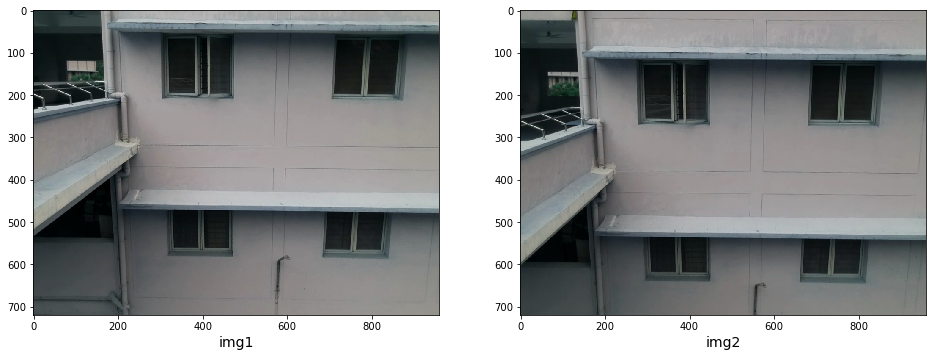

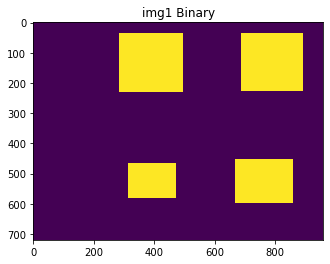

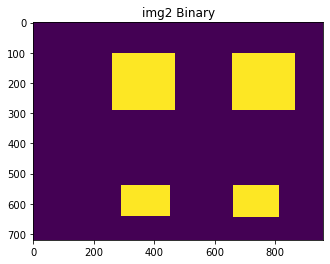

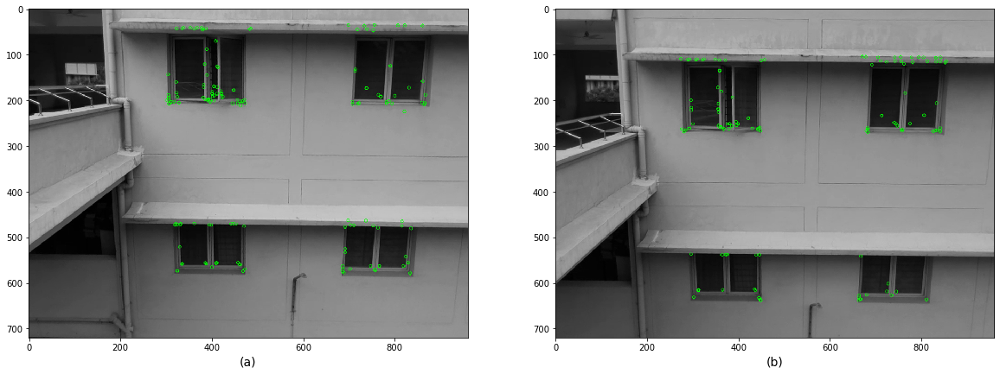

Using: bf feature matcher
Raw matches (Brute force): 93


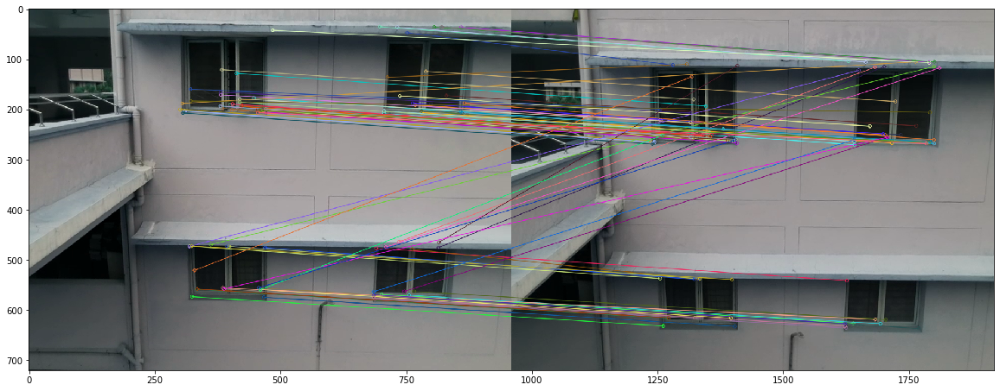

Final homography:  [[ 1.01578873e+00 -5.88389858e-03 -2.92079172e+01]
 [ 4.15367862e-03  9.81610732e-01  6.44773477e+01]
 [ 1.75636919e-05 -2.05538865e-05  1.00000000e+00]]
Final inliers count:  59
Inliers: [matrix([[865.50274658, 206.44111633, 840.15667725, 267.8586731 ]]), matrix([[310.23239136, 203.39758301, 284.35064697, 265.16390991]]), matrix([[468.02185059, 574.03625488, 444.41616821, 632.16369629]]), matrix([[468.02185059, 574.03625488, 444.41616821, 632.16369629]]), matrix([[447.59567261, 177.57131958, 421.31039429, 239.23736572]]), matrix([[701.88964844, 568.56982422, 679.74041748, 625.6015625 ]]), matrix([[334.63085938, 558.38549805, 311.62808228, 615.83740234]]), matrix([[799.94915771, 190.07150269, 774.21600342, 251.11296082]]), matrix([[466.55218506, 202.27966309, 441.49194336, 263.36221313]]), matrix([[769.00994873, 191.68424988, 743.29187012, 251.48744202]]), matrix([[334.63085938, 558.38549805, 311.62808228, 615.83740234]]), matrix([[466.55218506, 202.27966309, 441.491

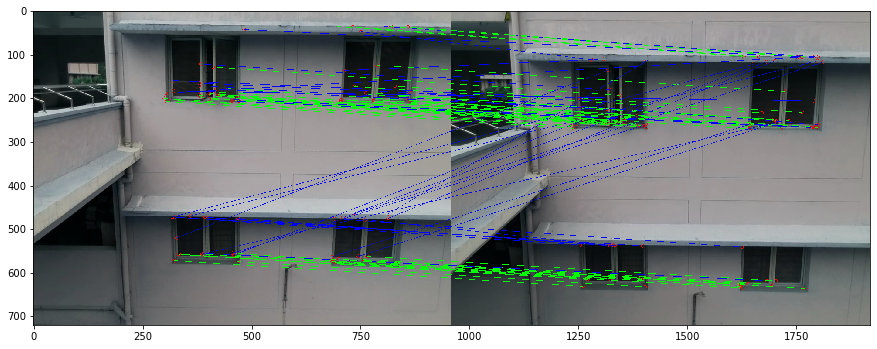

pick1: [[674, 457, 856, 592], [320, 472, 470, 577], [289, 42, 492, 225], [693, 40, 890, 222]]
pick2: [[667, 545, 810, 640], [297, 542, 450, 635], [268, 107, 466, 287], [664, 107, 861, 285]]
box2:  [667, 545, 810, 640]
pointB:  (840, 267)
listA:  []
ElementA:  [693, 40, 890, 222]
count:  0
pointB:  (284, 265)
listA:  []
ElementA:  [289, 42, 492, 225]
count:  0
pointB:  (444, 632)
listA:  []
ElementA:  [320, 472, 470, 577]
count:  0
pointB:  (444, 632)
listA:  []
ElementA:  [320, 472, 470, 577]
count:  0
pointB:  (421, 239)
listA:  []
ElementA:  [289, 42, 492, 225]
count:  0
pointB:  (679, 625)
listA:  []
ElementA:  [674, 457, 856, 592]
count:  0
oldBox
newCountInItr: 0
box2:  [297, 542, 450, 635]
pointB:  (840, 267)
listA:  [[674, 457, 856, 592]]
ElementA:  [693, 40, 890, 222]
count:  0
pointB:  (284, 265)
listA:  [[674, 457, 856, 592]]
ElementA:  [289, 42, 492, 225]
count:  0
pointB:  (444, 632)
listA:  [[674, 457, 856, 592]]
ElementA:  [320, 472, 470, 577]
count:  0
oldBox
newCountInI

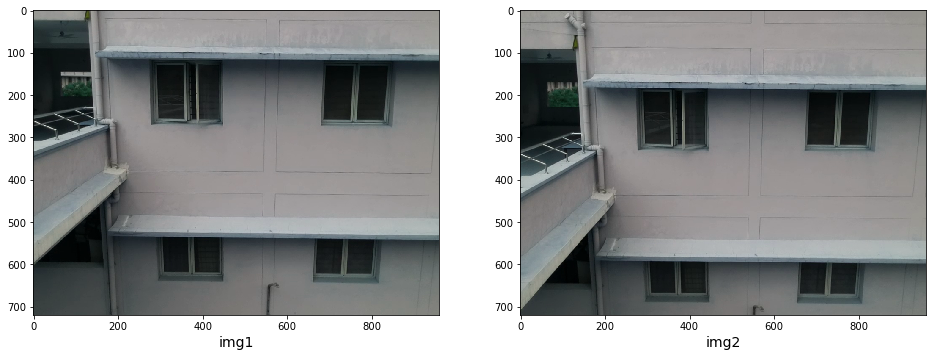

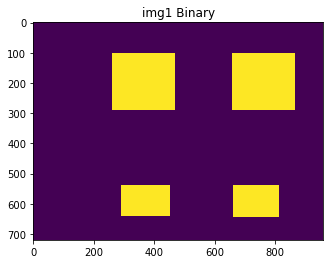

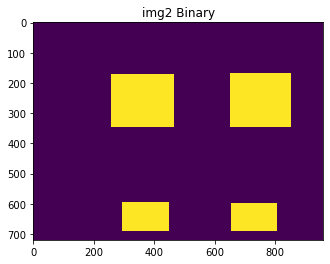

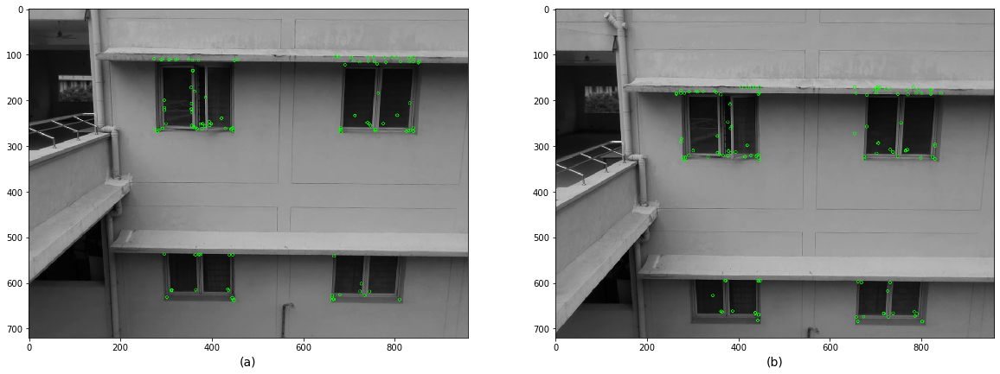

Using: bf feature matcher
Raw matches (Brute force): 87


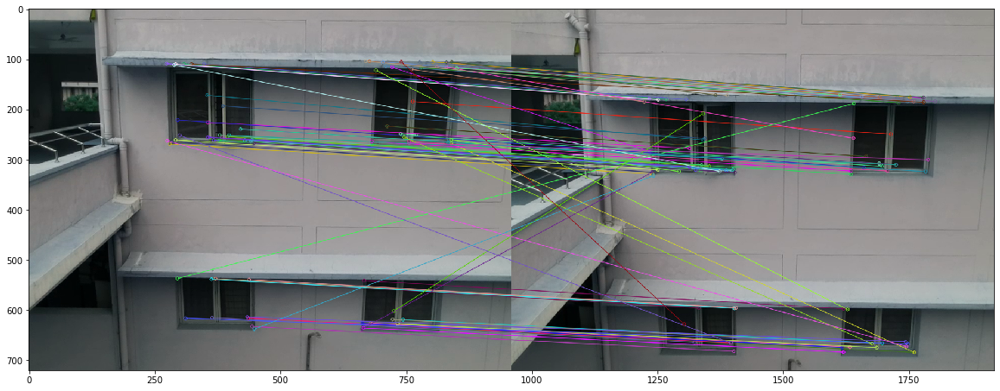

Final homography:  [[ 9.91452450e-01 -4.82337369e-03  3.04460951e+00]
 [ 2.83563121e-03  9.54817694e-01  7.45292563e+01]
 [ 1.29257972e-05 -1.41016749e-05  1.00000000e+00]]
Final inliers count:  55
Inliers: [matrix([[812.21575928, 115.09159088, 799.96691895, 184.59368896]]), matrix([[372.99942017, 538.11486816, 372.26989746, 595.37976074]]), matrix([[810.03295898, 636.01916504, 801.05822754, 684.01507568]]), matrix([[444.41616821, 632.16369629, 442.01419067, 681.55114746]]), matrix([[308.75888062, 109.88207245, 307.72268677, 180.06800842]]), matrix([[739.58483887, 248.66493225, 731.26477051, 307.86309814]]), matrix([[774.21600342, 251.11296082, 765.17584229, 309.95721436]]), matrix([[284.35064697, 265.16390991, 283.78497314, 325.19784546]]), matrix([[441.49194336, 263.36221313, 438.30407715, 322.55343628]]), matrix([[444.41616821, 632.16369629, 442.01419067, 681.55114746]]), matrix([[712.67993164, 233.51660156, 704.90496826, 293.61193848]]), matrix([[273.88336182, 109.08513641, 273.659

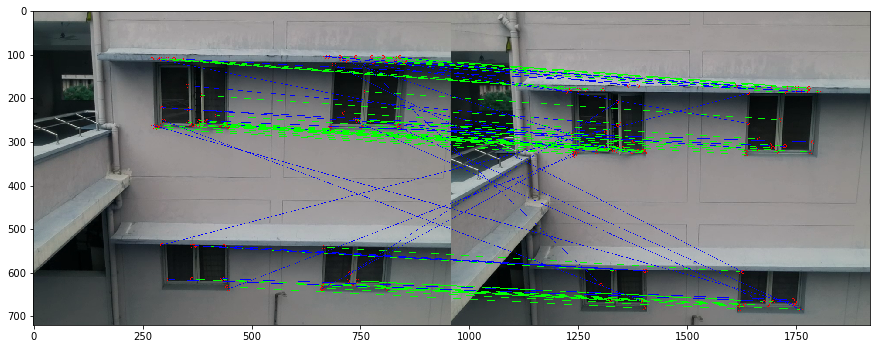

pick1: [[667, 545, 810, 640], [297, 542, 450, 635], [268, 107, 466, 287], [664, 107, 861, 285]]
pick2: [[300, 600, 445, 685], [662, 602, 802, 685], [264, 177, 462, 342], [658, 175, 850, 342]]
box2:  [300, 600, 445, 685]
pointB:  (799, 184)
listA:  []
ElementA:  [664, 107, 861, 285]
count:  0
pointB:  (372, 595)
listA:  []
ElementA:  None
count:  0
pointB:  (801, 684)
listA:  []
ElementA:  [667, 545, 810, 640]
count:  0
pointB:  (442, 681)
listA:  []
ElementA:  [297, 542, 450, 635]
count:  0
oldBox
newCountInItr: 0
box2:  [662, 602, 802, 685]
pointB:  (799, 184)
listA:  [[297, 542, 450, 635]]
ElementA:  [664, 107, 861, 285]
count:  0
pointB:  (372, 595)
listA:  [[297, 542, 450, 635]]
ElementA:  None
count:  0
pointB:  (801, 684)
listA:  [[297, 542, 450, 635]]
ElementA:  [667, 545, 810, 640]
count:  0
oldBox
newCountInItr: 0
box2:  [264, 177, 462, 342]
pointB:  (799, 184)
listA:  [[297, 542, 450, 635], [667, 545, 810, 640]]
ElementA:  [664, 107, 861, 285]
count:  0
pointB:  (372, 595)
li

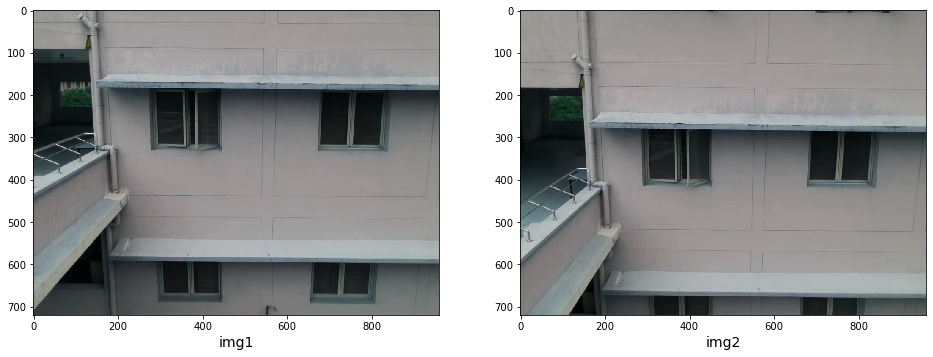

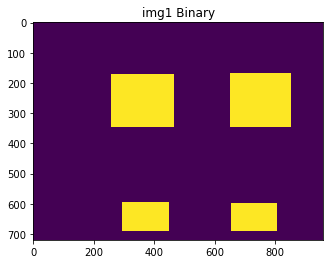

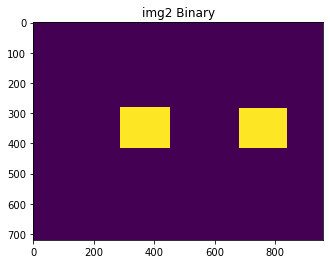

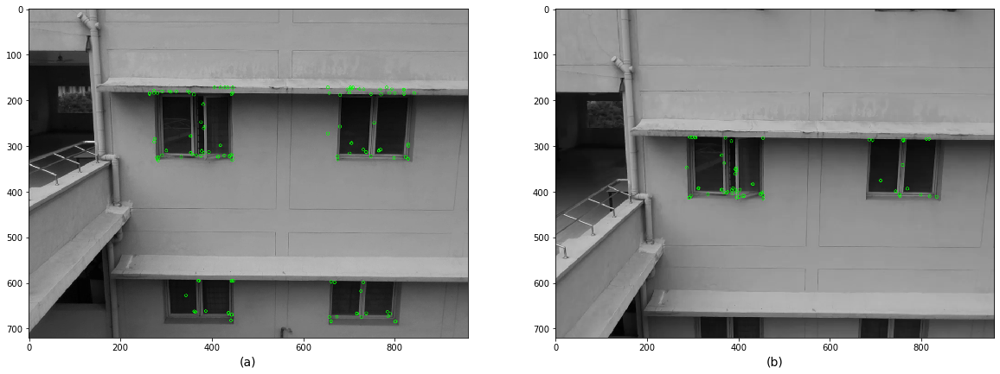

Using: bf feature matcher
Raw matches (Brute force): 45


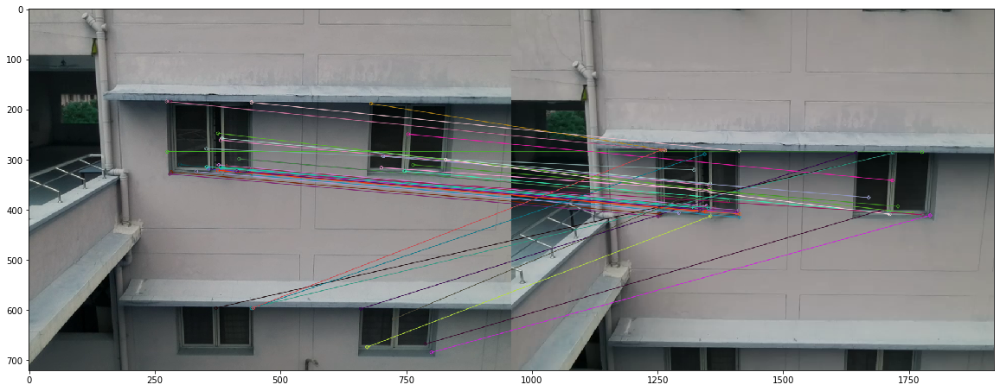

Final homography:  [[ 1.00941188e+00 -1.60383654e-02  1.24512137e+01]
 [ 1.83814441e-02  8.82430024e-01  1.13056031e+02]
 [ 2.91022447e-05 -2.33995709e-05  1.00000000e+00]]
Final inliers count:  25
Inliers: [matrix([[764.7723999 , 310.18002319, 768.53271484, 393.18399048]]), matrix([[438.30407715, 322.55343628, 447.46368408, 405.97485352]]), matrix([[384.12088013, 257.80578613, 394.84643555, 347.76275635]]), matrix([[377.69454956, 310.65463257, 387.83374023, 392.28665161]]), matrix([[300.67599487, 309.96685791, 312.48666382, 392.03109741]]), matrix([[443.0256958 , 186.23858643, 452.79498291, 283.12548828]]), matrix([[283.78497314, 325.19784546, 295.70999146, 408.79309082]]), matrix([[281.08706665, 184.53573608, 293.34460449, 280.67633057]]), matrix([[439.79660034, 320.10018921, 448.86450195, 402.87896729]]), matrix([[704.90496826, 293.61193848, 710.18536377, 375.5690918 ]]), matrix([[358.20065308, 318.58990479, 368.71334839, 402.11877441]]), matrix([[444.48751831, 325.74295044, 453.662

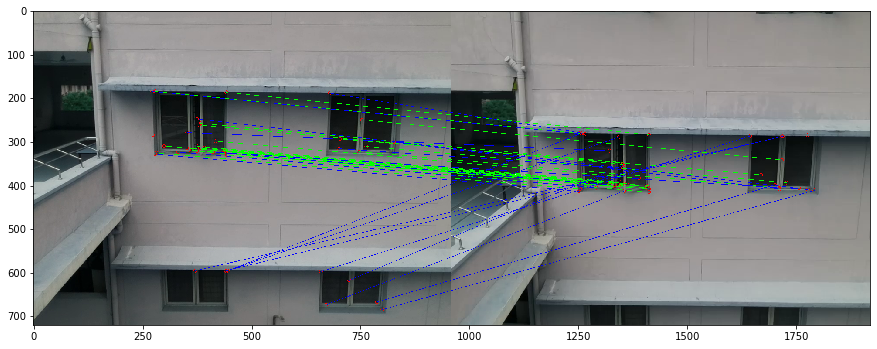

pick1: [[300, 600, 445, 685], [662, 602, 802, 685], [264, 177, 462, 342], [658, 175, 850, 342]]
pick2: [[292, 285, 450, 412], [687, 290, 837, 412]]
box2:  [292, 285, 450, 412]
pointB:  (768, 393)
listA:  []
ElementA:  [658, 175, 850, 342]
count:  0
pointB:  (447, 405)
listA:  []
ElementA:  [264, 177, 462, 342]
count:  0
oldBox
newCountInItr: 0
box2:  [687, 290, 837, 412]
pointB:  (768, 393)
listA:  [[264, 177, 462, 342]]
ElementA:  [658, 175, 850, 342]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0
Total windows are: 6


In [323]:

# grab the paths to the input images and initialize our images list
print("[INFO] loading images...")
imagePaths = sorted(list(paths.list_images(imgPath)))
images = []
# loop over the image paths, load each one, and add them to our
# images to stitch list
for imagePath in imagePaths:
    image = cv2.imread(imagePath, 1)
#     print(image.shape)
    images.append(image)
    print(imagePath)
    
print(images[0].shape)

windowCount = len(FinalList[0])
print("startWindowCount:", windowCount)
## MAIN LOOP ##
for i in range(len(images) - 1):
    img1 = images[i]
    img2 = images[i+1]
    
#     print(img1.shape)
    # read images and transform them to grayscale
    # Make sure that the train image is the image that will be transformed
    # Opencv defines the color channel in the order BGR 
    # Transform it to RGB to be compatible to matplotlib
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
    img2_gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
    ax1.imshow(img1, cmap="gray")
    ax1.set_xlabel("img1", fontsize=14)
    ax2.imshow(img2, cmap="gray")
    ax2.set_xlabel("img2", fontsize=14)
    plt.show()
    
    ## Preparing Binary Mask and mapping bounding box coordinates
    ## COORDS1 and COORDS2 : WOULD COME FROM TEXT FILE
#     coords1 = batch_data_int[i]
#     coords1 = np.array(coords1)
#     print(coords1)
#     coords1 = coords1.reshape(-1, 2)
#     coords1 = np.reshape(coords1,(coords1.shape[0]//4 , 4, coords1.shape[1]))
    
#     coords2 = batch_data_int[i+1]
#     coords2 = np.array(coords2)
#     coords2 = coords2.reshape(-1,2)
#     coords2 = np.reshape(coords2,(coords2.shape[0]//4 , 4, coords2.shape[1]))
    
    coords1 = FinalList[i]
    coords2 = FinalList[i+1]
#     print(coords1)
    
    img1_binary = prepareBinaryMask(img1_gray, coords1)
    img2_binary = prepareBinaryMask(img2_gray, coords2)
    plt.figure()
    plt.title('img1 Binary')
    plt.imshow(img1_binary)
    plt.show()
    plt.title('img2 Binary')
    plt.imshow(img2_binary)
    plt.show()

    ## Commented as the coords would come from recorded text File.
    ## LEFT TO DO
    pick1 = mapToPickv1(coords1)
    pick2 = mapToPickv1(coords2)
        
    kpsA, featuresA = detectAndDescribe(img1_gray, img1_binary, method=feature_extractor)
    kpsB, featuresB = detectAndDescribe(img2_gray, img2_binary, method=feature_extractor)
#     print('featuresA: ')
#     print(featuresA)
#     print('featuresB: ')
#     print(featuresB)
#     print(len(kpsA))
#     print(kpsB)
    
    # display the keypoints and features detected on both images
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
    ax1.imshow(cv2.drawKeypoints(img1_gray,kpsA,None,color=(0,255,0)))
    ax1.set_xlabel("(a)", fontsize=14)
    ax2.imshow(cv2.drawKeypoints(img2_gray,kpsB,None,color=(0,255,0)))
    ax2.set_xlabel("(b)", fontsize=14)
    plt.show()
    
    # Match Feature Points
    print("Using: {} feature matcher".format(feature_matching))
    fig = plt.figure(figsize=(20,8))
    if feature_matching == 'bf':
        matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,matches[:100],
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    elif feature_matching == 'knn':
        matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,np.random.choice(matches,100),
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img3)
    plt.show()
    
    ## Calculating homography and rejecting outliers
    correspondenceList = []
    estimation_thresh = 0.60
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)

    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
    print("Inliers: " +  str(inliers))
    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    
    print("pick1:", pick1)
    print("pick2:", pick2)
    newWindows, newWindowsCount = calculateUnMatchedWindows(inliers, pick1, pick2)
    windowCount += newWindowsCount

print('Total windows are:', windowCount)